<a href="https://colab.research.google.com/github/ElenStr/BreakHis/blob/main/Breakhis_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
%tensorflow_version 2.x
import tensorflow as tf
import tensorflow_addons as tfa
import numpy as np
import os
import matplotlib.pyplot as plt
from pickle import load, dump
import sys
import functools


# Load Data

In [2]:
# patient ids/class e.g. ids[0] : patients with Adenosis 
path = 'drive/My Drive/TFRecord_ds/'
ids = load(open(path+'ids.pkl','rb') )
zoom_ids = load(open(path+'zoom_ids.pkl','rb'))

raw_image_dataset = tf.data.TFRecordDataset(tf.data.Dataset.list_files("drive/My\ Drive/TFRecord_ds/img_*.tfrecord",shuffle=False))

image_feature_description = {
    'id' : tf.io.FixedLenFeature([], tf.string),
    'zoom' :  tf.io.FixedLenFeature([], tf.int64), 
    'label': tf.io.FixedLenFeature([], tf.int64),
    'image_raw': tf.io.FixedLenFeature([], tf.string),
}

def _parse_image_function(example_proto):
  # Parse the input tf.Example proto using the dictionary above.
  return tf.io.parse_single_example(example_proto, image_feature_description)

parsed_image_dataset = raw_image_dataset.map(_parse_image_function)

# Split Dataset

In [3]:
from random import shuffle, seed
from collections import defaultdict
seed(10)

other_paper = True
set_indices = []
paper_indices  = [(),(),(),(),(21,6,11),(),(2,1,2),()]

def filter_patient_fn(img_dict,id_set,i):
  return tf.math.logical_and(
                       tf.math.equal(img_dict['label'], tf.constant(i, dtype='int64')), 
                       tf.reduce_any(tf.convert_to_tensor(list(map(lambda id: tf.math.equal(img_dict['id'], id),id_set)))))

def split_dataset(ds, train_ratio, val_ratio, ids):
  splitted_ids = {k:[] for k in ['Val', 'Train', 'Test']}
  num_of_patients = defaultdict(int)
  # split every class patientwise
  for i,id_set in enumerate(ids):
    id_set = list(sorted(id_set))
    shuffle(id_set)
    ids_size = len(id_set)
    if (i!=4 and i!=6) or other_paper:
      test_idx = round(train_ratio*ids_size)
      # keep at least 1 patient for testing
      test_idx = test_idx-1 if test_idx==ids_size else test_idx
      val_idx  = round(val_ratio*test_idx)
      # keep at least 1 patient for validation
      val_idx = 1 if not val_idx else val_idx
    else :
      test_idx = ids_size - paper_indices[i][2]
      val_idx = paper_indices[i][1]

    
    splitted_ids['Val'].append(id_set[:val_idx])
    splitted_ids['Train'].append(id_set[val_idx:test_idx])
    splitted_ids['Test'].append(id_set[test_idx:])

    num_of_patients['Val']+=val_idx
    num_of_patients['Train']+=test_idx-val_idx
    num_of_patients['Test']+=ids_size-test_idx
    set_indices.append(( test_idx-val_idx,val_idx,ids_size-test_idx))

  dss = {k : tuple(ds.filter(lambda im: filter_patient_fn(im, set_ids, i))
               for i,set_ids in enumerate(ids_lists)) for k,ids_lists in splitted_ids.items() }
 
  
  ret = {k: functools.reduce(lambda a, b: a.concatenate(b), d).map(lambda img_dict : (img_dict['image_raw'], img_dict['label'])) for k, d in dss.items()}
  return ret,num_of_patients



## Split per zoom

In [4]:
train_zoom, val_zoom, test_zoom = {}, {}, {}
train_zoom_sz, val_zoom_sz, test_zoom_sz = {}, {}, {}

for k in zoom_ids.keys():
  ds_at_zoom = parsed_image_dataset.filter(lambda img : tf.math.equal(img['zoom'], tf.constant(k, dtype='int64')))
  splitted = split_dataset(ds_at_zoom, 0.9, 1/9, ids)
  dss = splitted[0]
  num_of_patients = splitted[1]
  train_zoom[k], val_zoom[k], test_zoom[k] = dss['Train'], dss['Val'], dss['Test']
  train_zoom_sz[k],val_zoom_sz[k],test_zoom_sz[k] =  num_of_patients['Train'], num_of_patients['Val'], num_of_patients['Test']

In [5]:
zoom = 40
train_parsed, val_parsed , test_parsed =  train_zoom[zoom], val_zoom[zoom], test_zoom[zoom]
train_patients, val_patients, test_patients = train_zoom_sz[zoom], val_zoom_sz[zoom], test_zoom_sz[zoom] 

In [ ]:
print(train_patients, val_patients, test_patients) 

42 15 25


## Whole Dataset Split

In [ ]:
splitted = split_dataset(parsed_image_dataset, 0.8, 0.1, ids)
train_parsed, val_parsed , test_parsed = splitted[0]['Train'], splitted[0]['Val'], splitted[0]['Test']
train_patients, val_patients , test_patients = splitted[1]['Train'], splitted[1]['Val'], splitted[1]['Test']


# Count

In [6]:
# Save time ^^
distribution = defaultdict(list)

#0.9, 1/9, zoom 40
distribution['Train'] =  [70, 204, 58, 121, 674, 161, 83, 91]
distribution['Val'] =  [15, 23, 13, 16, 92, 29, 51, 19]
distribution['Test'] =  [29, 26, 38, 12, 98, 15, 22, 35]

# 0.8, .15 whole ds
# distribution['Train'] = [262, 665, 235, 452, 2491, 554, 351, 353]
# distribution['Val'] = [61, 81, 60, 64, 234, 119, 201, 65]
# distribution['Test'] = [121, 268, 158, 53, 726, 119, 74, 142]

# attention by selection distr
# distribution['Train'] = [70, 123, 58, 105, 459, 73, 63, 61]
# distribution['Val'] = [15, 37, 13, 16, 167, 75, 51, 19]
# distribution['Test'] = [29, 93, 38, 28, 238, 57, 42, 65] 

# my distrib 
# distribution['Train'] = [70, 123, 58, 105, 436, 73, 83, 61]
# distribution['Val'] = [15, 37, 13, 16, 190, 75, 51, 19]
# distribution['Test'] = [29, 93, 38, 28, 238, 57, 22, 65] 


In [ ]:
distribution = defaultdict(list)
for distr, parsed in zip(['Train', 'Val', 'Test'], [train_parsed, val_parsed, test_parsed]):
  distribution[distr] = [0 for i in range(8)]

  for _,l in parsed.as_numpy_iterator():
    distribution[distr][l]+=1

  print(f"{distr}: {distribution[distr]}")


Train: [70, 204, 58, 121, 674, 161, 83, 91]
Val: [15, 23, 13, 16, 92, 29, 51, 19]
Test: [29, 26, 38, 12, 98, 15, 22, 35]


In [7]:
train_size = sum(distribution['Train'])
val_size = sum(distribution['Val'])              
test_size = sum(distribution['Test'])              

# size of train, validation and test set respectively
train_size, val_size, test_size

(1462, 258, 275)

In [9]:
max_num_of_instances = max(distribution['Train'])
number_of_transformations = [ max_num_of_instances//v - 1 for v in distribution['Train']]

# number of transformations needed per class to improve balance
number_of_transformations

[8, 2, 10, 4, 0, 3, 7, 6]

# Preprocess

In [232]:
# run for no augmentation
number_of_transformations = [2 for i in range(8)]


In [9]:
AUTOTUNE = tf.data.experimental.AUTOTUNE # https://www.tensorflow.org/guide/data_performance
batch_size = 32
image_size = 224


In [10]:
from random import randint, random, choice

# def rotate_image(image, deg):
#   image  = tfa.image.rotate(image,tf.constant(deg*1.))
#   return image
  
# def random_rotate(x):  
#   image  =  tfa.image.rotate(x,tf.constant(randint(0, 359)*1.))
#   return image
def apply_rnd_transformation(x, transformations):
  f = choice(transformations)
  return f[0](*((x,)+f[1:])) if random()<.5 else x

def augment_data(ds,transformations):
  augmented = [ds.map(lambda x,l: ( f[0](*((x,)+f[1:])), l) ) for f in transformations  ]
  ret = functools.reduce(lambda a, b: a.concatenate(b), [ds]+augmented)
  return ret
# for a set of transformation functions f1,f2,..,fn return fn(...(f2(f1(x))))
def fold_transformations(ds, transformations):
  return ds.map(lambda x,l: ((functools.reduce(lambda i,f: f[0](*((i,)+f[1:])), transformations, x)), l))

def apply_rnd_transformations(ds, transformations):
  return ds.map(lambda x,l: ( apply_rnd_transformation(x,transformations), l))


In [11]:

def mean_stdev(ds, size):
  means = np.zeros((3))
  sum_tmp = np.zeros((3))
  for im,l in ds.as_numpy_iterator():
    for i in range(3):
      means[i]+=tf.reduce_mean(im[:,:,i])
  means = (batch_size * means)/(size)

  for im,l in ds.as_numpy_iterator():
    for i in range(3):
      sum_tmp[i]+=(tf.reduce_sum((im[:,:,i] - means[i])**2))

  stdevs = np.sqrt(sum_tmp / (size * 224 *224 ))
  means = np.repeat([np.repeat([means], 224, axis=0)], 224,axis=0)
  stdevs = np.repeat([np.repeat([stdevs], 224, axis=0)], 224,axis=0)
  return means, stdevs


In [233]:
from operator import truediv

def _input_fn(ds): 
  return ds.repeat().batch(batch_size).prefetch(buffer_size=AUTOTUNE)
  
preprocess = [(tf.io.decode_jpeg, 3 ), (tf.image.resize, [image_size, image_size]),
              # (tf.image.resize_with_crop_or_pad, 460, 700), # not all images have exactly the same dimensions
              ( tf.cast, tf.float32),
              (tf.image.per_image_standardization, )
              #  (truediv, 255.)
              ]
val ,test = [ fold_transformations(ds, preprocess).cache()
                      for ds in [val_parsed , test_parsed ]
                    ]
train_per_class = [ train_parsed.filter(lambda _,l : tf.math.equal(l, tf.constant(i, 'int64'))) for i in range(8)]
train_per_class = [  fold_transformations(ds, preprocess).cache() for ds in train_per_class] 

aug_size=train_size
if any(number_of_transformations):
  transformations = [
                    (tf.image.flip_up_down,  ), (tf.image.flip_left_right,) , (tf.image.rot90, 1) ,  (tf.image.rot90, 3), 
                      (tf.image.rot90, 2) ]#,(tf.image.random_brightness, 0.3),  (tf.roll, [round(image_size*.2) for _ in range(3)], [0,1,2]) , 
                      # (tf.image.random_contrast,.2, .5), (tf.image.adjust_saturation, .5) ]

  rnd_transformations = [(tf.image.random_flip_up_down, 42 ), (tf.image.random_flip_left_right, 42)  ] #,(tf.image.random_brightness, 0.3, 42),  (tf.image.random_contrast,.2, .5, 42)]

  ds_size =  min( d*(min(t, len(transformations))+1) for d,t in zip(distribution['Train'], number_of_transformations))

  aug_train_per_class = [ augment_data(ds, transformations[:min(n, len(transformations))])  for ds,n in zip(train_per_class, number_of_transformations)]

  # aug_train_per_class[4] = apply_rnd_transformations(aug_train_per_class[4], transformations) # apply random transformations to majority class
  aug_distribution = [d*(min(t, len(transformations))+1) for d,t in zip(distribution['Train'], number_of_transformations)]
  aug_size = sum(aug_distribution)

# train set too large to fit in shuffle buffer, use sampling  to randomly shuffle 
train_concatenated = tf.data.experimental.sample_from_datasets(train_per_class, [.125]*8, seed=10) 

# train_concatenated = tf.data.experimental.sample_from_datasets(train_per_class, \
                                                              #  [(train_size - d)/(train_size*(train_size-1)) for d in distribution['Train']],
                                                              #  seed=10)
# GCN
# means_stdevs = [ mean_stdev(functools.reduce(lambda a, b: a.concatenate(b), [train_concatenated, val, test]), sum([aug_size, val_size, test_size]))]*3
# sets  = [ st.map(lambda im,l: ((im-mu)/sg,l)) for st,(mu,sg) in zip([train_concatenated, val, test], means_stdevs)]
# train_concatenated, val, test = sets

train_ds = _input_fn(train_concatenated.shuffle(aug_size, seed=10))
val_ds = _input_fn(val.shuffle(val_size, seed=10))
test_ds = _input_fn(test.shuffle(test_size, seed=10))


In [235]:
steps = aug_size//batch_size
# class_weight = {k : (1/distr)*(aug_size/8.) for k,distr in enumerate(aug_distribution) } # argument to pass as class weight in fit()
# class_weight = {k : (1/ (distr*7))*(aug_size)/8. for k,(distr, tr) in enumerate(zip(distribution['Train'], number_of_transformations)) }
print(aug_size)
print(steps)

4386
137


In [234]:
val_ds = _input_fn(val.concatenate(test).shuffle(val_size+test_size, seed=10))

# Model

## Resnet18

In [ ]:
!pip install torch torchvision
!pip install onnx onnxruntime
!pip install fire
!git clone https://github.com/AxisCommunications/onnx-to-keras.git

In [284]:
import torchvision.models as models
import torch

resnet18 = models.resnet18(pretrained=True)
dummy_input = torch.randn(32, 3, 224, 224)
torch.onnx.export(resnet18, dummy_input, "resnet18.onnx")

In [ ]:
!python3 onnx-to-keras/onnx2keras.py resnet18.onnx resnet18.h5

In [391]:
import re
from keras.models import Model

def insert_layer_nonseq(model, layer_regex, insert_layer_factory,
                        insert_layer_name=None, position='after'):

    # Auxiliary dictionary to describe the network graph
    network_dict = {'input_layers_of': {}, 'new_output_tensor_of': {}}

    # Set the input layers of each layer
    for layer in model.layers:
        for node in layer._outbound_nodes:
            layer_name = node.outbound_layer.name
            if layer_name not in network_dict['input_layers_of']:
                network_dict['input_layers_of'].update(
                        {layer_name: [layer.name]})
            else:
                # network_dict['input_layers_of'][layer_name].append(layer.name)

                if (layer.name not in network_dict['input_layers_of'][layer_name]):
                  network_dict['input_layers_of'][layer_name].append(layer.name)

    # Set the output tensor of the input layer
    network_dict['new_output_tensor_of'].update(
            {model.layers[0]._name: model.input})

    # Iterate over all layers after the input
    model_outputs = []
    for layer in model.layers[1:]:

        # Determine input tensors
        layer_input = [network_dict['new_output_tensor_of'][layer_aux] 
                for layer_aux in network_dict['input_layers_of'][layer.name]]
        if len(layer_input) == 1:
            layer_input = layer_input[0]

        # Insert layer if name matches the regular expression
        if re.match(layer_regex, layer.name):
            if position == 'replace':
                x = layer_input
            elif position == 'after':
                x = layer(layer_input)
            elif position == 'before':
                pass
            else:
                raise ValueError('position must be: before, after or replace')

            new_layer = insert_layer_factory()
            if insert_layer_name:
                new_layer.name = insert_layer_name
            else:
                new_layer._name = '{}_{}'.format(layer.name, new_layer.name)
            x = new_layer(x)
            print('New layer: {} Old layer: {} Type: {}'.format(new_layer.name,
                                                            layer.name, position))
            if position == 'before':
                x = layer(x)
        else:
            x = layer(layer_input)

        # Set new output tensor (the original one, or the one of the inserted
        # layer)
        network_dict['new_output_tensor_of'].update({layer._name: x})

        # Save tensor in output list if it is output in initial model
        if layer_name in model.output_names:
            model_outputs.append(x)

    return Model(inputs=model.inputs, outputs=model_outputs)

In [ ]:
from tensorflow.keras.layers import *
tf.keras.backend.clear_session()
mod = tf.keras.models.load_model('resnet18.h5')

In [ ]:
t_model = tf.keras.Model(inputs=mod.input, outputs=mod.get_layer(index=-4).output)
t_model.trainable=False
for layer in t_model.layers[56:]:
  layer.trainable = True
# model.summary()

In [ ]:

x = t_model.output    
# x = Dropout(.5)(x)
x = GlobalAveragePooling2D()(x)
x = Dropout(.5)(x)
x = Dense(128)(x)
# x = Dropout(.5)(x)
x = Dense(8)(x)
out = Softmax()(x)
hope_model = tf.keras.Model(inputs=t_model.input, outputs=out)
conf = defaultdict()
for layer in hope_model.layers[56:]:
  conf = layer.get_config()
  if 'kernel_regularizer' in conf:
    layer.kernel_regularizer = tf.keras.regularizers.l2(0.001)
  
# hope_model.summary()

In [ ]:
def dropout_layer_factory():
    return Dropout(rate=0.5)
drop = insert_layer_nonseq(hope_model, '.*conv2d.*', dropout_layer_factory)

In [ ]:
tmp = Model(inputs=drop.input, outputs=drop.output[-1])

In [ ]:
tmp.compile(optimizer=tf.keras.optimizers.SGD(learning_rate=0.001, momentum=0.9), loss='sparse_categorical_crossentropy', metrics='acc')

In [432]:
history = tmp.fit(train_ds, epochs=5, shuffle=False, steps_per_epoch=steps,validation_data=val_ds, validation_steps=(val_size+test_size)//batch_size )

Epoch 1/5
137/137 [==============================] - 18s 129ms/step - loss: 1.7236 - acc: 0.4713 - val_loss: 2.1013 - val_acc: 0.1113
Epoch 2/5
137/137 [==============================] - 18s 129ms/step - loss: 1.6572 - acc: 0.4902 - val_loss: 2.0976 - val_acc: 0.1016
Epoch 3/5
 29/137 [=====>........................] - ETA: 12s - loss: 1.6990 - acc: 0.4731

KeyboardInterrupt: ignored

In [269]:
history = hope_model.fit(train_ds, epochs=20, initial_epoch=5, steps_per_epoch=steps,validation_data=val_ds, validation_steps=(val_size+test_size)//batch_size )


Epoch 6/20
137/137 [==============================] - 15s 107ms/step - loss: 0.5436 - acc: 0.8045 - val_loss: 2.5333 - val_acc: 0.4297
Epoch 7/20
137/137 [==============================] - 15s 107ms/step - loss: 0.4760 - acc: 0.8264 - val_loss: 2.6653 - val_acc: 0.4160
Epoch 8/20
137/137 [==============================] - 15s 107ms/step - loss: 0.3947 - acc: 0.8540 - val_loss: 2.7011 - val_acc: 0.4316
Epoch 9/20
137/137 [==============================] - 15s 107ms/step - loss: 0.3691 - acc: 0.8691 - val_loss: 2.6915 - val_acc: 0.4355
Epoch 10/20
137/137 [==============================] - 15s 107ms/step - loss: 0.2995 - acc: 0.8866 - val_loss: 2.7697 - val_acc: 0.4336
Epoch 11/20
137/137 [==============================] - 15s 107ms/step - loss: 0.2891 - acc: 0.8969 - val_loss: 2.9625 - val_acc: 0.4238
Epoch 12/20
137/137 [==============================] - 15s 107ms/step - loss: 0.2404 - acc: 0.9122 - val_loss: 2.8227 - val_acc: 0.4375
Epoch 13/20
137/137 [==============================]

KeyboardInterrupt: ignored

In [262]:
history = hope_model.fit(train_ds, epochs=40, initial_epoch=20,steps_per_epoch=steps,validation_data=val_ds, validation_steps=(val_size+test_size)//batch_size )


Epoch 21/40
137/137 [==============================] - 15s 107ms/step - loss: 1.1075 - acc: 0.6375 - val_loss: 2.4139 - val_acc: 0.3770
Epoch 22/40
137/137 [==============================] - 15s 108ms/step - loss: 1.0841 - acc: 0.6490 - val_loss: 2.3883 - val_acc: 0.3730
Epoch 23/40
137/137 [==============================] - 15s 107ms/step - loss: 1.0755 - acc: 0.6474 - val_loss: 2.4218 - val_acc: 0.3770
Epoch 24/40
137/137 [==============================] - 15s 108ms/step - loss: 1.0060 - acc: 0.6713 - val_loss: 2.3741 - val_acc: 0.4023
Epoch 25/40
137/137 [==============================] - 15s 107ms/step - loss: 1.0328 - acc: 0.6610 - val_loss: 2.4301 - val_acc: 0.3770
Epoch 26/40
137/137 [==============================] - 15s 107ms/step - loss: 0.9806 - acc: 0.6788 - val_loss: 2.3905 - val_acc: 0.3906
Epoch 27/40
137/137 [==============================] - 15s 108ms/step - loss: 0.9853 - acc: 0.6832 - val_loss: 2.5195 - val_acc: 0.3789
Epoch 28/40
137/137 [===========================

KeyboardInterrupt: ignored

## Any pretrained

In [ ]:
 def model(pretrained, size, no_fine_tune=True, freeze=1 ):
      PRETRAINED_MODEL=pretrained(input_shape=(size, size,3), include_top=False, weights='imagenet')

      PRETRAINED_MODEL.trainable = True
      if no_fine_tune:
        for layer in PRETRAINED_MODEL.layers[:round(len(PRETRAINED_MODEL.layers)*freeze)]:
          layer.trainable =  False
      dropout_layer1 = tf.keras.layers.Dropout(0.5)

      dense_layer2 = tf.keras.layers.Dense(512,activation='relu')
      dropout_layer3 = tf.keras.layers.Dropout(0.5)

      dense_layer1 = tf.keras.layers.Dense(256,kernel_regularizer=tf.keras.regularizers.l1(0.0001),activation='relu')
      dropout_layer2 = tf.keras.layers.Dropout(0.5)

      dense_layer3 = tf.keras.layers.Dense(128,activation='relu')
      dropout_layer4 = tf.keras.layers.Dropout(0.5)

      dense_layer4 = tf.keras.layers.Dense(16,kernel_regularizer=tf.keras.regularizers.l2(),activation='relu')

      global_max_layer = tf.keras.layers.GlobalMaxPooling2D()
      global_avg_layer = tf.keras.layers.GlobalAveragePooling2D()
      
      batch_norm = tf.keras.layers.BatchNormalization()
      batch_norm1 = tf.keras.layers.BatchNormalization()

      flatten = tf.keras.layers.Flatten()
      
      # add top layer  classification
      prediction_layer = tf.keras.layers.Dense(8,activation='softmax')
      # prediction_layer = tf.keras.layers.Dense(4, activation='linear', kernel_regularizer=tf.keras.regularizers.l2())
      dropout_layer2 = tf.keras.layers.Dropout(0.5)
      model = tf.keras.Sequential([PRETRAINED_MODEL,global_avg_layer, dropout_layer1, batch_norm, dense_layer1, batch_norm1,dropout_layer2,dense_layer3 ,prediction_layer ])
      # model = tf.keras.Sequential([PRETRAINED_MODEL,global_avg_layer, dropout_layer1,batch_norm,dense_layer1,dropout_layer2,batch_norm1,dense_layer3,dropout_layer4,prediction_layer ])

      lr = tf.keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=0.0002, decay_rate=0.7, decay_steps=2)
      model.compile(optimizer=tf.optimizers.RMSprop(learning_rate=0.00001, decay=.000001), loss=tf.keras.losses.sparse_categorical_crossentropy , metrics=["accuracy"])
      
      model.summary()
      return model

In [ ]:
the_model = model(tf.keras.applications.VGG16,image_size, freeze=.5) 
learn_control = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_accuracy', patience=5,
                                  verbose=1,factor=0.2, min_lr=1e-7)

history = the_model.fit(train_ds, epochs=10,steps_per_epoch=steps, validation_data=val_ds, validation_steps=val_size// batch_size,  class_weight=class_weight)

58892288/58889256 [==============================] - 1s 0us/step
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
global_average_pooling2d (Gl (None, 512)               0         
_________________________________________________________________
dropout (Dropout)            (None, 512)               0         
_________________________________________________________________
batch_normalization_38 (Batc (None, 512)               2048      
_________________________________________________________________
dense_5 (Dense)              (None, 256)               131328    
_________________________________________________________________
batch_normalization_39 (Batc (None, 256)               1024      
_________________________________________________________

KeyboardInterrupt: ignored

In [ ]:
history = the_model.fit(train_ds, epochs=20,initial_epoch=10,steps_per_epoch=steps, validation_data=val_ds, validation_steps=val_size// batch_size,  class_weight=class_weight)


Epoch 11/20
341/341 [==============================] - 88s 259ms/step - loss: 1.4977 - accuracy: 0.5291 - val_loss: 2.2427 - val_accuracy: 0.3984
Epoch 12/20
341/341 [==============================] - 85s 251ms/step - loss: 1.3899 - accuracy: 0.5539 - val_loss: 2.1797 - val_accuracy: 0.3945
Epoch 13/20
341/341 [==============================] - 84s 246ms/step - loss: 1.2996 - accuracy: 0.5883 - val_loss: 2.5468 - val_accuracy: 0.3398
Epoch 14/20
341/341 [==============================] - 84s 246ms/step - loss: 1.2738 - accuracy: 0.6120 - val_loss: 2.1519 - val_accuracy: 0.3320
Epoch 15/20
341/341 [==============================] - 84s 246ms/step - loss: 1.2101 - accuracy: 0.6235 - val_loss: 2.5125 - val_accuracy: 0.3438
Epoch 16/20
341/341 [==============================] - 84s 246ms/step - loss: 1.1393 - accuracy: 0.6604 - val_loss: 2.2880 - val_accuracy: 0.3359
Epoch 17/20
341/341 [==============================] - 84s 246ms/step - loss: 1.0925 - accuracy: 0.6681 - val_loss: 2.3909 -

# Attention Model

In [ ]:
from tensorflow.keras import Model
from tensorflow.keras.layers import *

import tensorflow as tf
import numpy as np



## Metrics

In [ ]:
class ImageLevelAccuracy(tf.keras.metrics.Metric):

  def __init__(self, name='image_level_accuracy', **kwargs):
    super(ImageLevelAccuracy, self).__init__(name=name, **kwargs)
    self.n_rec= self.add_weight(name='n_rec', initializer='zeros')
    self.cnt = self.add_weight(name='count', initializer='zeros')
    self.majority = 3*tf.ones(4, dtype='int64')
    

  def update_state(self, y_true, y_pred, sample_weight=None):
    y_pred = tf.reshape(tf.argmax(y_pred, axis=1), [4,5])
    y_true = tf.reshape(y_true,[4,5])
    v = tf.equal(y_true, y_pred)
    # count correctly classified patches
    v = tf.math.reduce_sum(tf.cast(v, dtype='int64'), axis=1)  
    # count correctly classified images TODO: if no majority in training should we select more patches?
    v = tf.reduce_sum(tf.cast(tf.greater_equal(v,self.majority), 'int64'))
    self.n_rec.assign_add(tf.cast(v,'float32'))
    self.cnt.assign_add(tf.cast(4, dtype='float32'))

  def result(self):
    return self.n_rec/self.cnt
 
  def reset_states(self):
    self.n_rec.assign(0)
    self.cnt.assign(0)



In [ ]:
my_acc = ImageLevelAccuracy() 


## Soft Attention

In [ ]:
def image_cross_entropy_loss(y_true, y_pred):
  class_prob = tf.reduce_sum(tf.one_hot(tf.squeeze(y_true), depth=8)*y_pred, axis=1)
  y_image = tf.reduce_mean(tf.reshape(class_prob, (4,5)), axis=1)
  return -tf.reduce_mean(tf.math.log(y_image))


In [ ]:
def residual_unit(inp, patch_size=112, is_first=False):
  # A
  a = Conv2D(input_shape=(patch_size, patch_size, 3),filters=64, kernel_size=1)(inp) if is_first else Conv2D(filters=64, kernel_size=1)(inp)
  a = BatchNormalization( momentum=.1, epsilon=1e-5)(a) # PyTorch different default values

  # B
  # b = Conv2D(input_shape=(patch_size+2, patch_size+2, 3),filters=64, kernel_size=1)(inp) if is_first else Conv2D(filters=64, kernel_size=1)(inp) # when zero padding at beginning
  b =  Conv2D(filters=64, kernel_size=1)(inp)

  b = BatchNormalization(momentum=.1, epsilon=1e-5)(b) # PyTorch different default values
  b = PReLU(shared_axes=[1,2], alpha_initializer=tf.keras.initializers.constant(.25))(b)
  b = Conv2D(filters=64, kernel_size=3)(b)
  b = BatchNormalization(momentum=.1, epsilon=1e-5)(b) # PyTorch different default values
  b = PReLU(shared_axes=[1,2], alpha_initializer=tf.keras.initializers.constant(.25))(b)
  b = Conv2D(filters=64, kernel_size=1)(b)
  b = BatchNormalization(momentum=.1, epsilon=1e-5)(b)

  # a = patch_size X patch_size, b = (patch_size-2) X (patch_size-2) 
  b = ZeroPadding2D()(b)
  

  output = Add()([a,b])
  
  return output

In [ ]:
patch = Input(shape=( 112,112,3),name='input' )

# SaNet
# let patch be the patch
ru = residual_unit(patch, True)

# Trunk 
t = residual_unit(ru)
t = residual_unit(t)

# Mask
m = MaxPool2D(pool_size=3, strides=2)(ru)
m = residual_unit(m)
m = residual_unit(m)

m = MaxPool2D(pool_size=3, strides=2)(m)
m = residual_unit(m)
m = residual_unit(m)

m = UpSampling2D(interpolation='bilinear')(m)
m = BatchNormalization(momentum=.1, epsilon=1e-5)(m)
m = PReLU(shared_axes=[1,2], alpha_initializer=tf.keras.initializers.constant(.25))(m)
m = residual_unit(m)

m = ZeroPadding2D()(m)
m = UpSampling2D(interpolation='bilinear')(m)
m = BatchNormalization(momentum=.1, epsilon=1e-5)(m)
m = PReLU(shared_axes=[1,2], alpha_initializer=tf.keras.initializers.constant(.25))(m)
m = residual_unit(m)

m = Conv2D(filters=64, kernel_size=1, activation='sigmoid')(m)

x = Multiply()([m+1, t])
# x = AveragePooling2D(pool_size=5, strides=1)(x)
x = GlobalAveragePooling2D()(x)
# x = Flatten()(x)
deep = Dense(128, activation='relu', name='feature_layer')(x)
output = Dense(8)(deep)
output = Softmax()(output)

lr = tf.keras.optimizers.schedules.ExponentialDecay(initial_learning_rate=.01, decay_steps=steps*200, decay_rate=.95)

SA_Net = Model(inputs=patch, outputs=output)
SA_Net.compile(optimizer=tf.keras.optimizers.Adam(), loss=image_cross_entropy_loss, metrics=[my_acc])
# SA_Net.summary()

In [ ]:
SA_Net_features = Model(inputs=SA_Net.input, outputs=SA_Net.get_layer('feature_layer').output)

In [ ]:
np.random.seed(12)

In [ ]:
train_iter = train_ds.as_numpy_iterator()
val_iter = val_ds.as_numpy_iterator()


### Testing area 


In [ ]:
batch = val_iter.next()
# positions = np.hstack([(np.random.randint(66,394, size=(4,5))/460.) , (np.random.randint(66,634, size=(4,5))/700.)]).reshape(4,5,2)
# shallow = np.zeros((4,5,7))
# shallows=[]
# deeps=[]
# avg_loss = 0.
# avg_acc = 0.

# guard=0
# cropped = [0]*4
# l = []
# b = []

In [ ]:

# show_batch(batch, positions)
# exctract 5 patches for each image in mini batch
glmps = [tf.image.extract_glimpse(batch[0], size=(112,112), offsets=positions[:, i, :], centered=True, normalized=True) for i in range(5)] 
glmps = tf.concat(glmps, 0)
labels = np.vstack([batch[1]]*5 ).T
# 6 loc_x, 7 loc_y
# shallow[:,:,5] = positions[:,:,0]
# shallow[:,:,6] = positions[:,:,1]
# # 3 pred, 4 true pred
# shallow[:,:,3] = np.argmax(SA_Net.predict_on_batch(glmps), axis=1).reshape(4,5)
# shallow[:,:,4] = labels


# shallow_t = tf.convert_to_tensor(shallow, dtype=tf.float64)
# deep = tf.reshape(SA_Net_features(glmps), (4,5,128))

# if not val:
#   deeps.append(deep)
#   shallows.append(shallow_t)

# out = [o.numpy() for o in De_Net([deep,shallow_t ]) ] 

# patches = glmps.numpy().reshape(4,5, 112,112,3)
# # print(positions[0])
# # iterate over DeNet actions, select patches and update centers for next iter
# for i,im in enumerate(out[1]):
#   for j,o in enumerate(im):
#     if (out[0][i][j][0]>=out[0][i][j][1] and cropped[i] <5) or (guard>15 and cropped[i]<5):
#       b.append(patches[i][j])
#       l.append(labels[i][j])
#       cropped[i]+=1
#     # avoid croping the edges
#     y = np.clip(o[0]+np.random.normal(scale=20/460), 0,1) *164/230
#     x = np.clip(o[1]+np.random.normal(scale=20/700), 0, 1)*294/350

#     positions[i,j,:] = [y , x ]
# # out = SA_Net.train_on_batch(glmps.numpy, labels)

In [ ]:
step = 0
historical_loss = 0
len(l)

In [ ]:
loss, acc =  SA_Net.train_on_batch(np.array(b[:20]), np.array(l[:20]))
      
avg_loss = ( avg_loss*step + loss) / (step + 1) # running average
avg_acc = (avg_acc*step + acc) / (step + 1)


# (historical?) training loss, state feauture 0
historical_loss =  ( historical_loss*(step + shallow[0][0][2] ) + loss) / (step + shallow[0][0][2] + 1)
shallow[:,:,0] = np.array([historical_loss]*20).reshape(4,5)
shallow[:,:,2] = np.array([shallow[0][0][2]+1]*20).reshape(4,5) # num of iterations (epochs?)

In [ ]:
l , acc = SA_Net.train_on_batch(glmps.numpy(), labels.reshape(20), )


In [ ]:
l, acc

In [ ]:
features = SA_Net.evaluate(glmps.numpy(), labels.reshape(20), batch_size=20, steps=1)
features

In [ ]:
tmp = tf.reduce_sum(tf.one_hot(tf.convert_to_tensor(labels.reshape(20), dtype='int64'),8)*pred, axis=-1) #, tf.math.reduce_max(pred, 1)
tf.reshape(tmp, [4,5])
# -tf.reduce_mean(tf.math.log(tmp))

In [ ]:
outputs[0]

In [ ]:
SA_Net.get_layer(index=4).get_weights()

In [ ]:
tf.reduce_max(SA_Net_features(glmps), axis=-1)

<tf.Tensor: shape=(20,), dtype=float32, numpy=
array([21.086494 , 10.8742285, 21.086494 , 15.585621 , 14.719896 ,
       16.163666 , 18.491693 , 21.170727 , 16.247528 ,  7.685578 ,
       20.991898 , 16.95435  , 13.575271 ,  7.7177725, 21.335249 ,
       19.59283  , 21.525051 , 11.263981 , 13.817575 , 11.287757 ],
      dtype=float32)>

In [ ]:
my_acc.update_state(tf.convert_to_tensor(labels.reshape(20), dtype='int64'), tf.convert_to_tensor(pred, 'float64'))
my_acc.result()

In [ ]:
pred = SA_Net.predict(glmps.numpy() )
tf.argmax(pred, axis=1).numpy().reshape(4,5), labels

In [ ]:
tf.reduce_mean(tf.keras.backend.sparse_categorical_crossentropy(labels.reshape(20),pred))

In [ ]:
positions

In [ ]:
def show_batch(batch, positions):
  bboxes = np.apply_along_axis( lambda y : [(y[0]+1)/2-66/460, (y[1]+1)/2-66/700, (y[0]+1)/2+66/460, (y[1]+1)/2+66/700], axis=-1, arr=positions )
  # bboxes = np.apply_along_axis( lambda y : [y[0]-66/460, y[1]-66/700, y[0]+66/460, y[1]+66/700], axis=-1, arr=positions )
  colors = np.array([[0.2, 0.0, 1.0]])
  to_show = tf.image.draw_bounding_boxes(batch[0], bboxes, colors)
  f, axarr = plt.subplots(2,2, figsize=(20,10))
  for i, im in enumerate(tf.unstack(to_show)):
    axarr[i//2,i % 2].imshow(im)

# show_batch(batch, positions)

## Hard Attention 

In [ ]:
# DeNet
deep = Input(shape=(5,128), batch_size=4, name='deep_input')
other_state = Input(shape=(5, 7), batch_size=4,name='other_input' )

norm_other_state = Lambda(lambda x:tf.keras.backend.l2_normalize(x,axis=2))(other_state)
norm_deep = Lambda(lambda x: tf.keras.backend.l2_normalize(x, axis=2))(deep)

fc_relu = Dense(32, activation='relu',kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01))(deep)
fc_tanh = Dense(10, activation='tanh',kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01))(other_state)
fc = Concatenate()([fc_tanh, fc_relu])
lstm_input = Dense(24,activation='relu',kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01))(fc)
lstm_output = LSTM(24, return_sequences=True)(lstm_input)
action = Dense(2, activation='sigmoid',kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01), \
               bias_initializer=tf.keras.initializers.Constant(2))(lstm_output)
loc_y = Dense(2, activation='sigmoid', kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01))(lstm_output)
loc_x = Dense(2, activation='sigmoid', kernel_initializer=tf.keras.initializers.RandomUniform(minval=-0.01, maxval=0.01))(lstm_output)

# crop = LSTM(2)(lstm_input)
# loc_y = LSTM(236)(lstm_input)
# loc_x = LSTM(476)(lstm_input)


In [ ]:
De_Net = Model(inputs=[deep, other_state], outputs = [action, loc_y, loc_x] )
# De_Net = Model(inputs=[deep, other_state], outputs = [action, loc] )
# De_Net = Model(inputs=[deep, other_state], outputs = [lstm_output] )


De_Net.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.001) )
# De_Net.summary()

## Experiments

### B2B 1 val 1 train

In [ ]:
def step_fn(batch, step, avg_loss=0., avg_acc=0., val=False):
  global positions, shallow

  
  cropped = 0
  guard = 0 # prevent infinite loop while cropping

  b = np.empty((4,5,112,112,3)) # batch for SaNet
  l = np.zeros((4,5), dtype='int')-1 # labels of batch for SaNet
  
  ds_per_ep = []
  shs_per_ep = []
  actions_per_ep = []
  actions_ts = np.zeros((3,4,5))
  
  while cropped<20: 
    guard+=1
    # exctract 5 patches for each image in mini batch
    glmps = [tf.image.extract_glimpse(batch[0], size=(112,112), offsets=positions[:, i, :], centered=True, normalized=True) for i in range(5)] 
    glmps = tf.concat(glmps, 0)
    labels = np.vstack([batch[1] for _ in range(5)]).T

    # 6 loc_x, 7 loc_y
    shallow[:,:,5] = positions[:,:,0]
    shallow[:,:,6] = positions[:,:,1]
    # 3 pred, 4 true pred
    shallow[:,:,3] = np.argmax(SA_Net.predict_on_batch(glmps), axis=1).reshape(4,5)
    shallow[:,:,4] = labels


    shallow_t = tf.convert_to_tensor(shallow, dtype=tf.float64)
    deep = tf.reshape(SA_Net_features(glmps), (4,5,128))

    if not val:
        ds_per_ep.append(deep)
        shs_per_ep.append(shallow_t)

    out = [o.numpy() for o in De_Net([deep,shallow_t ]) ] 

    patches = glmps.numpy().reshape(4,5, 112,112,3)
    # iterate over DeNet actions, select patches and update centers for next iter
    for i,im in enumerate(out[1]):
      for j,o in enumerate(im):
        actions_ts[0][i][j] = 0
        if l[i][j]==-1 and (out[0][i][j][1]-out[0][i][j][0]>=0. or guard>10 ):
          b[i][j] = patches[i][j]
          l[i][j] = labels[i][j]
          cropped+=1
          actions_ts[0][i][j] = 1
        # avoid croping the edges
        y = np.clip(tf.random.normal([1], mean=o[0], stddev=o[1], dtype=tf.float32), 66/230 -1, 394/230-1) #*164/230
        x = np.clip(tf.random.normal([1], mean=out[2][i][j][0], stddev=out[2][i][j][1], dtype=tf.float32), 66/350-1,634/350-1) #*294/350

        positions[i,j,:] = [y , x ]
        actions_ts[1][i][j] = y
        actions_ts[2][i][j] = x
    if not val:
      actions_per_ep.append(actions_ts)
  
  loss, acc = SA_Net.train_on_batch(b.reshape((20,112,112,3)), l.reshape((20,1)) ) if not val else SA_Net.test_on_batch(b.reshape((20,112,112,3)), l.reshape((20,1)) ) 
    
  avg_loss = ( avg_loss*step + loss) / (step + 1) # running average
  avg_acc = (avg_acc*step + acc) / (step + 1)
      
  if not val:
    return avg_loss, avg_acc, actions_per_ep, ds_per_ep, shs_per_ep, loss
  else:
    return avg_loss, avg_acc, guard


def train_epoch( historical_loss=0.):
  global positions, shallow
  avg_loss = 0.
  avg_acc = 0.
  
  deeps = []
  shallows = []
  actions = []
  rews = []
  for step in range(train_size//4):
    batch = train_iter.next()
    avg_loss, avg_acc, actions_per_ep, ds_per_ep, shs_per_ep, loss = step_fn(batch, step, avg_loss, avg_acc)
    
    sys.stdout.write(f"\r {len(actions_per_ep)} Step {step+1}: Loss {avg_loss} , Accuracy {avg_acc}")
    sys.stdout.flush()

    deeps.append(ds_per_ep)
    shallows.append(shs_per_ep)
    actions.append(actions_per_ep)

    # (historical?) training loss, state feauture 0
    historical_loss =  ( historical_loss*(step + shallow[0][0][2] ) + loss) / (step + shallow[0][0][2] + 1)
    shallow[:,:,0] = np.array([historical_loss]*20).reshape(4,5)
    shallow[:,:,2] = np.array([shallow[0][0][2]+1]*20).reshape(4,5) # num of iterations (epochs?)

    rp=0.
    val_loss = 0.
    for val_step in range(5):
      val_batch = val_iter.next()
      val_loss,rp, _ = step_fn(val_batch,val_step,val_loss, rp, val=True)

    rc  = -np.log(step/253 + 1e-15) if val_loss <= .25 else 0. 
    if rc : print('Found it!')   
    rews.append(rp+rc)
  
  print()
  val_acc=0.
  val_loss = 0.
  for step in range(val_size//4):
    val_batch = val_iter.next()
    val_loss,val_acc, guard = step_fn(val_batch,step, val_loss, val_acc,True)  
    
    sys.stdout.write(f"\r {guard} Step {step+1}:                          Val Loss {val_loss} , Val Accuracy {val_acc}")
    sys.stdout.flush()
 # update at the end of validation or during?
  shallow[:,:,1] = np.array([max(val_acc, shallow[0][0][1])]*20).reshape(4,5) # best val acc
    
  return deeps, shallows,actions, rews,historical_loss

In [ ]:
%%time
positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/230. - 1, np.random.randint(66,634, size=(4,5))/350. -1]).reshape(4,5,2)
# positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/460. , (np.random.randint(66,634, size=(4,5)))/700. ]).reshape(4,5,2)
shallow = np.zeros((4,5,7)) # all other but deep feautures of DeNet input
hist_rew = 0.

for epoch in range(5):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[[[r]*3]*5]*4 for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 6
 1 Step 253: Loss 1.5560118023880396 , Accuracy 0.35276679841897235
 1 Step 98:                          Val Loss 4.67695323757979 , Val Accuracy 0.3852040816326531
Epoch 7
 1 Step 253: Loss 1.5133222271743496 , Accuracy 0.35474308300395263
 1 Step 98:                          Val Loss 3.328320718845543 , Val Accuracy 0.2653061224489797
Epoch 8
 1 Step 253: Loss 1.4877003721907558 , Accuracy 0.3932806324110672
 1 Step 98:                          Val Loss 3.4554243691417637 , Val Accuracy 0.41836734693877553
Epoch 9
 1 Step 253: Loss 1.4786580167489929 , Accuracy 0.38537549407114613
 1 Step 98:                          Val Loss 3.2100332184713714 , Val Accuracy 0.44387755102040816
Epoch 10
 1 Step 253: Loss 1.5819512971054766 , Accuracy 0.3774703557312253
 1 Step 98:                          Val Loss 2.1427925070937803 , Val Accuracy 0.41836734693877553


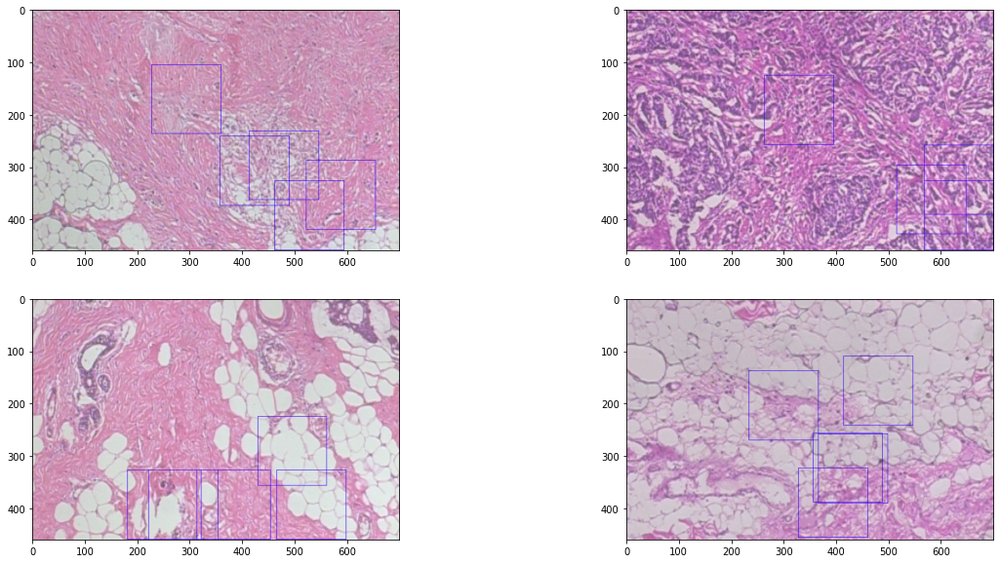

In [ ]:
for epoch in range(5,10):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 11
 1 Step 253: Loss 1.476734853568652 , Accuracy 0.365612648221344
 1 Step 98:                          Val Loss 2.0115861158285813 , Val Accuracy 0.41581632653061223
Epoch 12
 1 Step 253: Loss 1.4110496106625183 , Accuracy 0.3883399209486166
 1 Step 98:                          Val Loss 2.438808983838071 , Val Accuracy 0.39285714285714285
Epoch 13
 1 Step 253: Loss 1.5197275644646797 , Accuracy 0.36462450592885376
 1 Step 98:                          Val Loss 2.235678182572734 , Val Accuracy 0.3035714285714287
Epoch 14
 1 Step 253: Loss 1.5207813711259006 , Accuracy 0.3339920948616602
 1 Step 98:                          Val Loss 2.889673071096138 , Val Accuracy 0.4311224489795919
Epoch 15
 1 Step 253: Loss 1.6681028971441179 , Accuracy 0.31225296442687756
 1 Step 98:                          Val Loss 3.318949969447389 , Val Accuracy 0.11989795918367344
Epoch 16
 1 Step 253: Loss 1.519343533093043 , Accuracy 0.3478260869565219
 1 Step 98:                          Val Loss 2.651

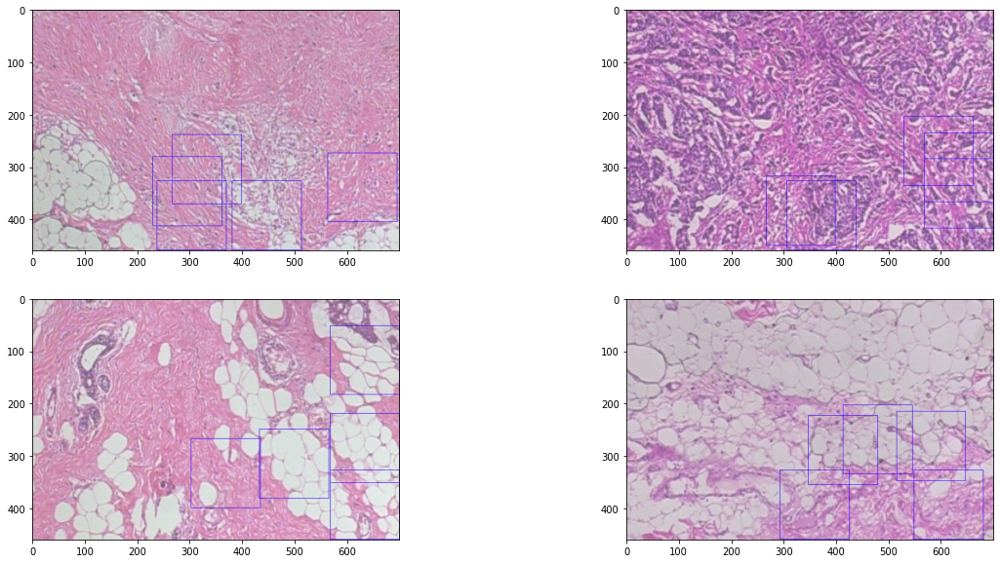

In [ ]:
for epoch in range(10,20):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

### Experiment 6/10 
* 1 train 5 val
* Zeorpadding before multiply in SaNet
* normalized, .125
* Default adam
* loc= continuous actions 


Epoch 1
 11 Step 253: Loss 1.3701456741514075 , Accuracy 0.3517786561264822
 11 Step 98:                          Val Loss 8.1737005993275 , Val Accuracy 0.4668367346938776
Epoch 2
 1 Step 253: Loss 1.5014235597773793 , Accuracy 0.3705533596837946
 1 Step 98:                          Val Loss 6.542048345125109 , Val Accuracy 0.4362244897959184
Epoch 3
 1 Step 253: Loss 1.499027159356275 , Accuracy 0.366600790513834
 1 Step 98:                          Val Loss 7.100901614960428 , Val Accuracy 0.42346938775510196
Epoch 4
 1 Step 253: Loss 1.5371827245671517 , Accuracy 0.3359683794466403
 1 Step 98:                          Val Loss 5.803341373207275 , Val Accuracy 0.4260204081632653
Epoch 5
 1 Step 253: Loss 1.4693889844593901 , Accuracy 0.3695652173913043
 1 Step 98:                          Val Loss 4.496625760327833 , Val Accuracy 0.43112244897959184
CPU times: user 1h 6min 28s, sys: 13min 28s, total: 1h 19min 57s
Wall time: 1h 25min 57s


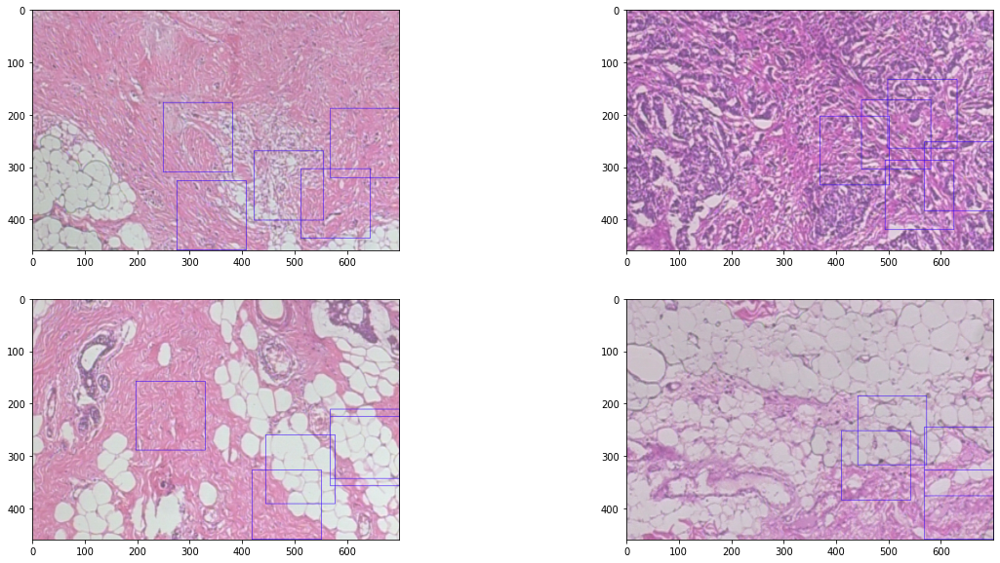

In [ ]:
%%time
positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/230. - 1, np.random.randint(66,634, size=(4,5))/350. -1]).reshape(4,5,2)
# positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/460. , (np.random.randint(66,634, size=(4,5)))/700. ]).reshape(4,5,2)
shallow = np.zeros((4,5,7)) # all other but deep feautures of DeNet input
hist_rew = 0.

for epoch in range(5):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 6
 1 Step 253: Loss 1.4835103789018653 , Accuracy 0.366600790513834
 1 Step 98:                          Val Loss 5.652878279930779 , Val Accuracy 0.39540816326530615
Epoch 7
 1 Step 253: Loss 1.5629458992554282 , Accuracy 0.3349802371541503
 1 Step 98:                          Val Loss 3.803662284296386 , Val Accuracy 0.34438775510204084
Epoch 8
 1 Step 253: Loss 1.603771304041735 , Accuracy 0.35968379446640314
 1 Step 98:                          Val Loss 3.17685793963622 , Val Accuracy 0.40816326530612257
Epoch 9
 1 Step 253: Loss 1.5639943654829336 , Accuracy 0.35869565217391297
 1 Step 98:                          Val Loss 2.734879998604255 , Val Accuracy 0.34183673469387754
Epoch 10
 1 Step 253: Loss 1.5713140638802838 , Accuracy 0.325098814229249
 1 Step 98:                          Val Loss 3.7327038801598307 , Val Accuracy 0.3979591836734694
Epoch 11
 1 Step 253: Loss 1.5013044752776925 , Accuracy 0.37549407114624506
 1 Step 98:                          Val Loss 2.405841

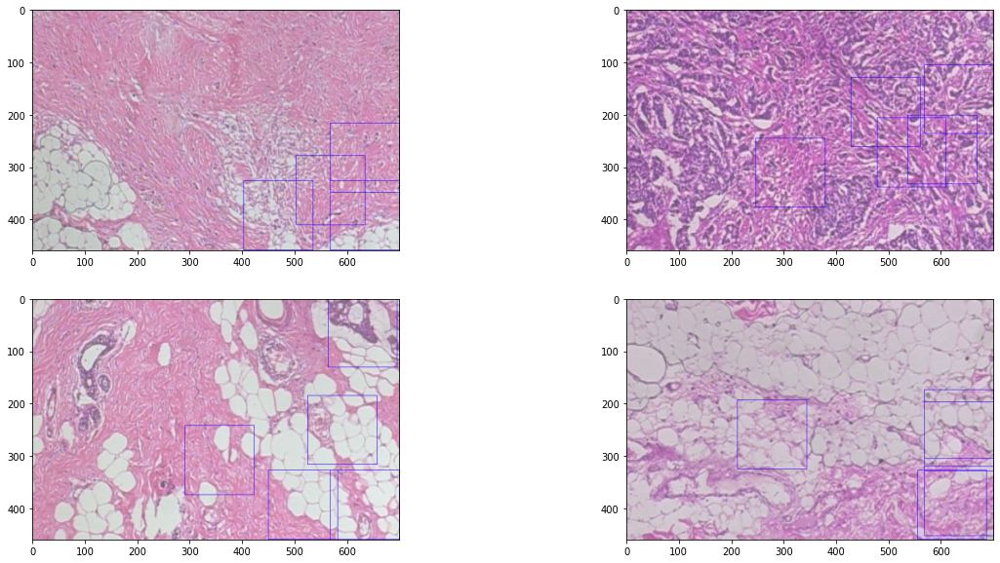

In [ ]:
%%time
for epoch in range(5,15):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 16
 1 Step 253: Loss 1.6066332377581722 , Accuracy 0.3359683794466402
 1 Step 98:                          Val Loss 2.743307072289136 , Val Accuracy 0.1989795918367347
Epoch 17
 1 Step 253: Loss 1.5304707912580944 , Accuracy 0.35968379446640314
 1 Step 98:                          Val Loss 3.1168228600706374 , Val Accuracy 0.2857142857142858
Epoch 18
 1 Step 253: Loss 1.4922341509195767 , Accuracy 0.35276679841897246
 1 Step 98:                          Val Loss 3.29492026901975 , Val Accuracy 0.3596938775510204
Epoch 19
 1 Step 253: Loss 1.5144590947762302 , Accuracy 0.33399209486166004
 1 Step 98:                          Val Loss 2.7820660697334283 , Val Accuracy 0.41836734693877553
Epoch 20
 1 Step 253: Loss 1.4481015264879358 , Accuracy 0.3606719367588933
 1 Step 98:                          Val Loss 3.247029877134732 , Val Accuracy 0.4107142857142857
Epoch 21
 1 Step 253: Loss 1.5015862980349506 , Accuracy 0.3409090909090909
 1 Step 98:                          Val Loss 2.7

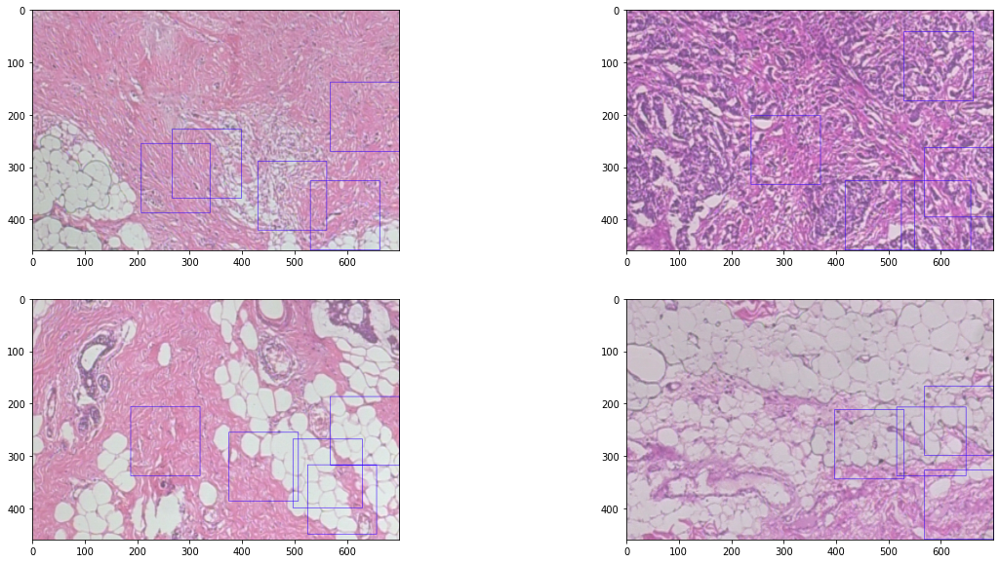

In [ ]:
%%time
for epoch in range(15,25):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

### Experiment 5/10
 * B2B
 * normalized, .125
 * Default adam
 * loc= continuous actions 

Epoch 1
 11 Step 253: Loss 1.3591417788800302 , Accuracy 0.3626482213438736
 11 Step 98:                          Val Loss 5.674413925932471 , Val Accuracy 0.45153061224489793
Epoch 2
 1 Step 253: Loss 1.5416587212973318 , Accuracy 0.32806324110671936
 1 Step 98:                          Val Loss 4.59396347640158 , Val Accuracy 0.40561224489795916
Epoch 3
 1 Step 253: Loss 1.4568343135830104 , Accuracy 0.3636363636363636
 1 Step 98:                          Val Loss 6.662003866458614 , Val Accuracy 0.42091836734693877
Epoch 4
 1 Step 253: Loss 1.5266737911460015 , Accuracy 0.358695652173913
 1 Step 98:                          Val Loss 6.495070259481176 , Val Accuracy 0.41836734693877553
Epoch 5
 1 Step 253: Loss 1.4332105970367233 , Accuracy 0.366600790513834
 1 Step 98:                          Val Loss 6.719970728784444 , Val Accuracy 0.42091836734693877
CPU times: user 27min 44s, sys: 8min 20s, total: 36min 4s
Wall time: 49min 54s


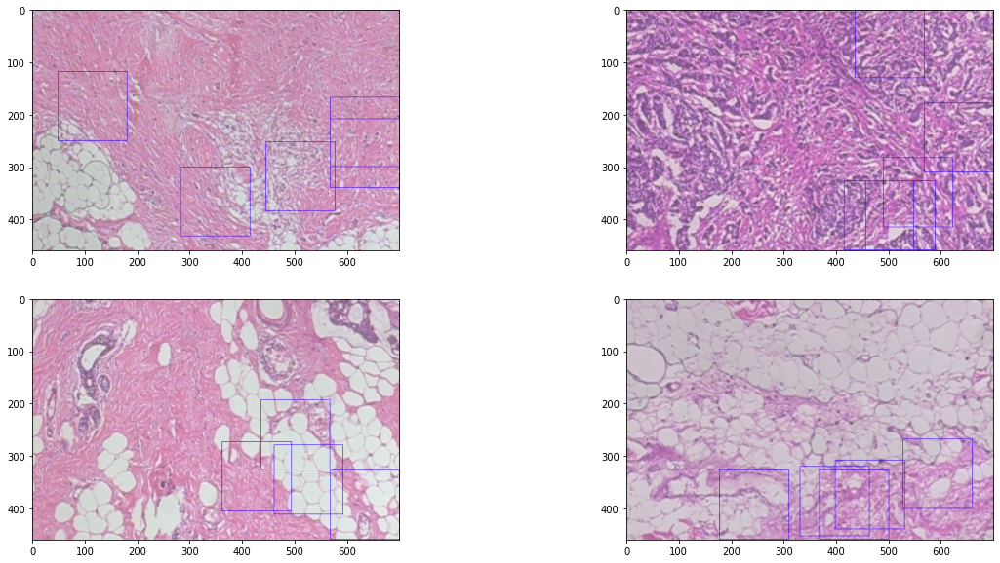

In [ ]:
%%time
positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/230. - 1, np.random.randint(66,634, size=(4,5))/350. -1]).reshape(4,5,2)
# positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/460. , (np.random.randint(66,634, size=(4,5)))/700. ]).reshape(4,5,2)
shallow = np.zeros((4,5,7)) # all other but deep feautures of DeNet input
hist_rew = 0.

for epoch in range(5):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 6
 1 Step 253: Loss 1.4902169008190795 , Accuracy 0.3764822134387351
 1 Step 98:                          Val Loss 3.327344294566167 , Val Accuracy 0.41836734693877553
Epoch 7
 1 Step 253: Loss 1.4158104438953143 , Accuracy 0.38241106719367607
 1 Step 98:                          Val Loss 4.542067739162215 , Val Accuracy 0.42091836734693877
Epoch 8
 1 Step 253: Loss 1.551786409197708 , Accuracy 0.3448616600790515
 1 Step 98:                          Val Loss 2.5330151313421685 , Val Accuracy 0.2959183673469387
Epoch 9
 1 Step 253: Loss 1.5261796408152506 , Accuracy 0.3764822134387353
 1 Step 98:                          Val Loss 2.6714034264489084 , Val Accuracy 0.4336734693877551
Epoch 10
 1 Step 253: Loss 1.4583102505057755 , Accuracy 0.3863636363636364
 1 Step 98:                          Val Loss 2.832128000740266 , Val Accuracy 0.413265306122449


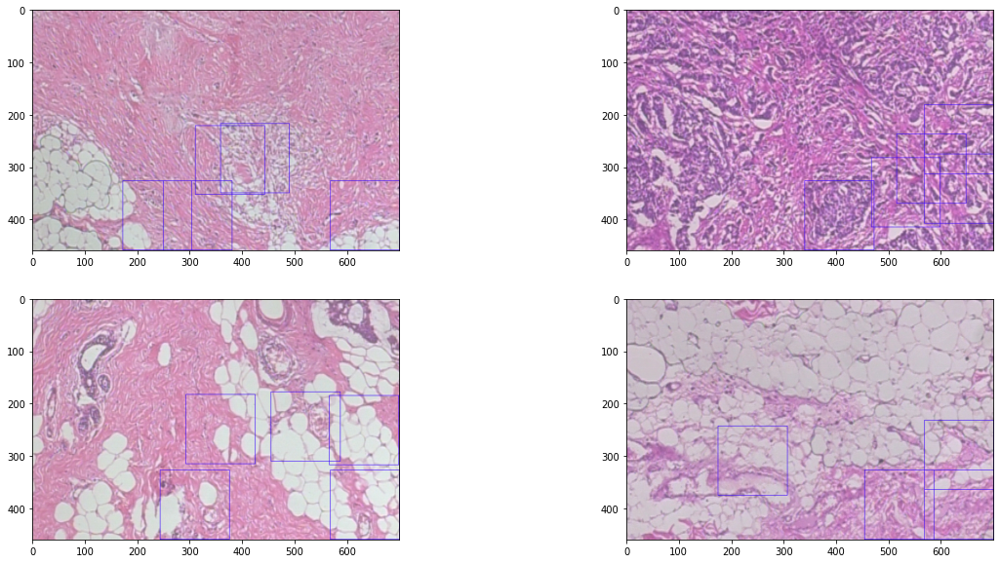

In [ ]:
for epoch in range(5,10):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

Epoch 11
 1 Step 253: Loss 1.447765170197139 , Accuracy 0.3764822134387351
 1 Step 98:                          Val Loss 3.0822313888644683 , Val Accuracy 0.3826530612244898
Epoch 12
 1 Step 253: Loss 1.489692822525741 , Accuracy 0.37450592885375494
 1 Step 98:                          Val Loss 2.4039358820538137 , Val Accuracy 0.40561224489795916


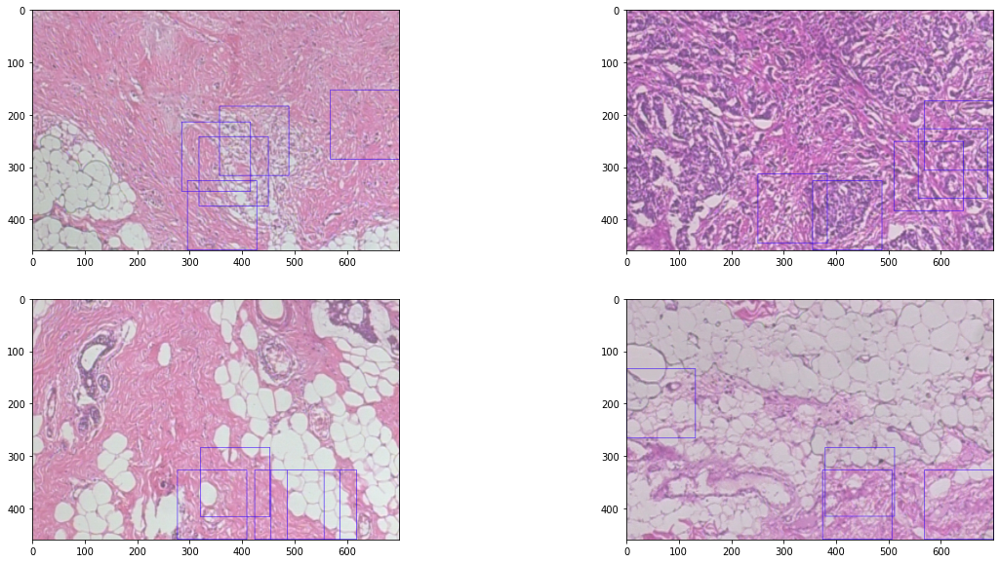

In [ ]:
for epoch in range(10,12):
  print(f"Epoch {epoch+1}")
  deeps,shallows, actions, rews , hist_loss= train_epoch(historical_loss=0. if not epoch else hist_loss)
  
  print()
  with tf.GradientTape() as policy_tape:
    sums = []
    for ep, (ds, os) in enumerate(zip(deeps,shallows)):
      outputs = [De_Net([d,o]) for d,o in zip(ds,os)]
      for ts,o in enumerate(outputs):
        select = tf.reduce_sum(tf.one_hot(actions[ep][ts][0],depth=2)*o[0], axis=-1)
        pdf_y = tf.exp(-0.5 *((actions[ep][ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
        pdf_x = tf.exp(-0.5 *((actions[ep][ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
        outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
      log_probs = tf.keras.backend.log(outputs)
      sums.append(tf.reduce_sum(log_probs, axis=[0,1,2]))
    sums = tf.stack(sums, axis=0)   
      
    policy_loss = -tf.reduce_mean(sums*(np.array([[r] for r in rews])-hist_rew), axis=0)
    policy_variables = De_Net.trainable_variables
    grads = policy_tape.gradient(policy_loss, policy_variables)
    De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  
  hist_rew = (hist_rew*epoch+np.mean(rews))/(epoch+1)

show_batch(batch, positions)

## Validation at epoch end

In [ ]:
def the_loop(iter,  val, size, start=False, historical_loss=0.):
  '''
  training or validation loop
  Arguments
    iter: data iterator 
    val: boolean, it is true if validation
    size: data size
    start: True when training for first epochs to select all cropped patches (may be unnecessary?)
  Returns
    deeps,shallows : all LSTM inputs to update gradients 
    avg_acc : average training/validation accuracy
  '''
  global positions, shallow
  avg_loss = 0.
  avg_acc = 0.
  
  deeps = []
  shallows = []
  actions_per_ep = []
  actions_ts = np.zeros((3,4,5))

  for step in range(size//4):
    batch = iter.next()
    cropped = 0
    guard = 0 # prevent infinite loop while cropping

    b = np.empty((4,5,112,112,3)) # batch for SaNet
    l = np.zeros((4,5), dtype='int')-1 # labels of batch for SaNet
    while cropped<20: 
      guard+=1
      # exctract 5 patches for each image in mini batch
      glmps = [tf.image.extract_glimpse(batch[0], size=(112,112), offsets=positions[:, i, :], centered=True, normalized=True) for i in range(5)] 
      glmps = tf.concat(glmps, 0)
      labels = np.vstack([batch[1] for _ in range(5)]).T

      # 6 loc_x, 7 loc_y
      shallow[:,:,5] = positions[:,:,0]
      shallow[:,:,6] = positions[:,:,1]
      # 3 pred, 4 true pred
      shallow[:,:,3] = np.argmax(SA_Net.predict_on_batch(glmps), axis=1).reshape(4,5)
      shallow[:,:,4] = labels


      shallow_t = tf.convert_to_tensor(shallow, dtype=tf.float64)
      deep = tf.reshape(SA_Net_features(glmps), (4,5,128))

      if not val:
        deeps.append(deep)
        shallows.append(shallow_t)

      out = [o.numpy() for o in De_Net([deep,shallow_t ]) ] 

      patches = glmps.numpy().reshape(4,5, 112,112,3)
      # print(positions[0])
      # iterate over DeNet actions, select patches and update centers for next iter
      for i,im in enumerate(out[1]):
        for j,o in enumerate(im):
          actions_ts[0][i][j] = 0
          if l[i][j]==-1 and (out[0][i][j][1]-out[0][i][j][0]>=0. or guard>10 ):
            b[i][j] = patches[i][j]
            l[i][j] = labels[i][j]
            cropped+=1
            actions_ts[0][i][j] = 1
          # avoid croping the edges
          y = np.clip(np.random.normal(loc=o[0], scale=o[1]) , 66/230 -1, 394/230-1) #*164/230
          x = np.clip(np.random.normal(loc= out[2][i][j][0], scale=out[2][i][j][1]), 66/350-1,634/350-1) #*294/350

          positions[i,j,:] = [y , x ]
          actions_ts[1][i][j] = y
          actions_ts[2][i][j] = x
      if not val:
        actions_per_ep.append(actions_ts)
   
    loss, acc = SA_Net.test_on_batch(b.reshape((20,112,112,3)), l.reshape((20,1))) if val else SA_Net.train_on_batch(b.reshape((20,112,112,3)), l.reshape((20,1)))
      
    avg_loss = ( avg_loss*step + loss) / (step + 1) # running average
    avg_acc = (avg_acc*step + acc) / (step + 1)

    if not val :
      # (historical?) training loss, state feauture 0
      historical_loss =  ( historical_loss*(step + shallow[0][0][2] ) + loss) / (step + shallow[0][0][2] + 1)
      shallow[:,:,0] = np.array([historical_loss]*20).reshape(4,5)
      shallow[:,:,2] = np.array([shallow[0][0][2]+1]*20).reshape(4,5) # num of iterations (epochs?)
    sys.stdout.write(f"\r {guard if guard>0 else ''} Step {step+1}: {'                         Val ' if val else ''}Loss {avg_loss} , {'Val ' if val else ''}Accuracy {avg_acc}")
    sys.stdout.flush()
  # update at the end of validation or during?
    if val:  
      shallow[:,:,1] = np.array([max(avg_acc, shallow[0][0][1])]*20).reshape(4,5) # best val acc
  return deeps, shallows,actions_per_ep,avg_acc,historical_loss

Epoch 1
 1 Step 253: Loss 1.3174519089341399 , Accuracy 0.3675889328063241
 1 Step 98:                          Val Loss 7.042652860052803 , Val Accuracy 0.4234693877551021
Epoch 2
 1 Step 253: Loss 1.4606413380799654 , Accuracy 0.3893280632411067
 1 Step 98:                          Val Loss 7.62316014825656 , Val Accuracy 0.4260204081632653
Epoch 3
 1 Step 253: Loss 1.5382718324510316 , Accuracy 0.3695652173913043
 1 Step 98:                          Val Loss 5.021045184532675 , Val Accuracy 0.4260204081632653
Epoch 4
 1 Step 253: Loss 1.489157531739456 , Accuracy 0.3557312252964426
 1 Step 98:                          Val Loss 6.079917292462243 , Val Accuracy 0.42346938775510207
Epoch 5
 1 Step 253: Loss 1.5720812073161474 , Accuracy 0.35177865612648235
 1 Step 98:                          Val Loss 4.826515197331603 , Val Accuracy 0.43112244897959184
CPU times: user 5min, sys: 1min 7s, total: 6min 8s
Wall time: 9min 16s


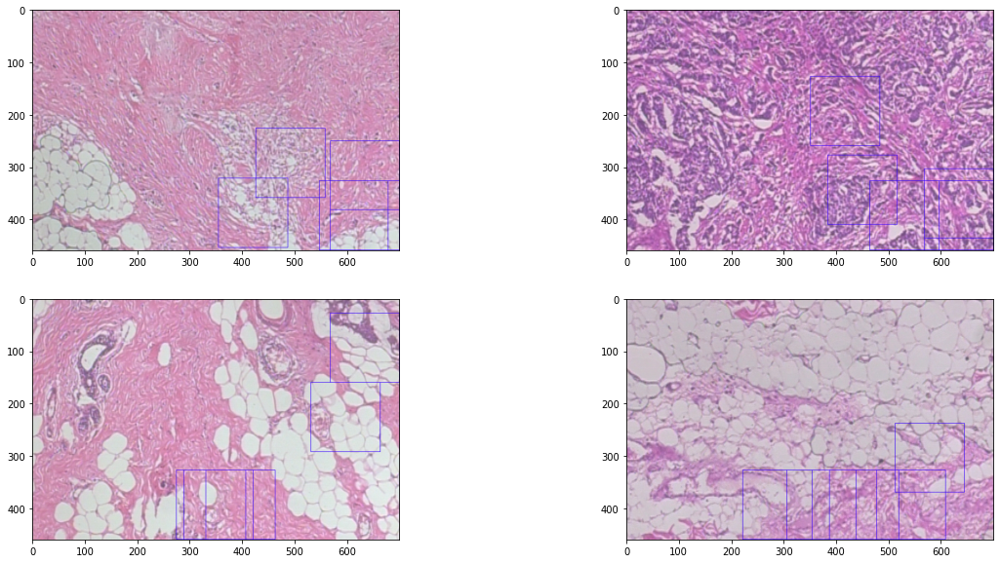

In [ ]:
%%time
# #random initial patch center positions
positions = np.hstack([(2*np.random.randint(66,394, size=(4,5)))/460. - 1, (2 *np.random.randint(66,634, size=(4,5)))/700. -1]).reshape(4,5,2)
# positions = np.hstack([(np.random.randint(66,394, size=(4,5)))/460. , (np.random.randint(66,634, size=(4,5)))/700. ]).reshape(4,5,2)
shallow = np.zeros((4,5,7)) # all other but deep feautures of DeNet input
hist_rew = 0.
rews = []
for epoch in range(5):
  print(f"Epoch {epoch+1}")
  deeps,shallows,actions,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,_,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for ts,o in enumerate(outputs):
      select = tf.reduce_sum(tf.one_hot(actions[ts][0],depth=2)*o[0], axis=-1)
      pdf_y = tf.exp(-0.5 *((actions[ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
      pdf_x = tf.exp(-0.5 *((actions[ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
      outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(log_probs, axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


In [ ]:
%%time
for epoch in range(15,20):
  print(f"Epoch {epoch+1}")
  deeps,shallows,actions,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,_,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for ts,o in enumerate(outputs):
      select = tf.reduce_sum(tf.one_hot(actions[ts][0],depth=2)*o[0], axis=-1)
      pdf_y = tf.exp(-0.5 *((actions[ts][1] - o[1][:,:,0]) / (o[1][:,:,1]))**2) * 1/(o[1][:,:,1]*tf.sqrt(2 *np.pi))
      pdf_x = tf.exp(-0.5 *((actions[ts][2] - o[2][:,:,0]) / (o[2][:,:,1]))**2) * 1/(o[2][:,:,1]*tf.sqrt(2 *np.pi))
      outputs[ts] = tf.stack([select, pdf_y,pdf_x], axis=-1  )
      
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(log_probs, axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 16
 1 Step 253: Loss 1.5391554612180474 , Accuracy 0.3725296442687746
 1 Step 98:                          Val Loss 4.504155943873434 , Val Accuracy 0.42346938775510207
Epoch 17
 1 Step 253: Loss 1.528631515587448 , Accuracy 0.3517786561264822
 1 Step 98:                          Val Loss 3.774064576291308 , Val Accuracy 0.41581632653061223
Epoch 18
 1 Step 20: Loss 3.2242209672927857 , Accuracy 0.175

KeyboardInterrupt: ignored

Epoch 11
 1 Step 252: Loss 1.7624468623055893 , Accuracy 0.4117063492063492
 1 Step 104:                          Val Loss 1.874201646504494 , Val Accuracy 0.4567307692307692
Epoch 12
 1 Step 252: Loss 1.6526933593833042 , Accuracy 0.43154761904761896
 1 Step 104:                          Val Loss 10.771111111944682 , Val Accuracy 0.4567307692307692
Epoch 13
 1 Step 252: Loss 2.0125846186327543 , Accuracy 0.39484126984126994
 1 Step 104:                          Val Loss 1.8758463679024806 , Val Accuracy 0.4567307692307692
Epoch 14
 1 Step 252: Loss 1.816839788996038 , Accuracy 0.43154761904761896
 1 Step 104:                          Val Loss 1.8365932396398141 , Val Accuracy 0.4567307692307692
Epoch 15
 1 Step 252: Loss 1.8021500964486403 , Accuracy 0.43154761904761896
 1 Step 104:                          Val Loss 1.826748977486904 , Val Accuracy 0.4567307692307692


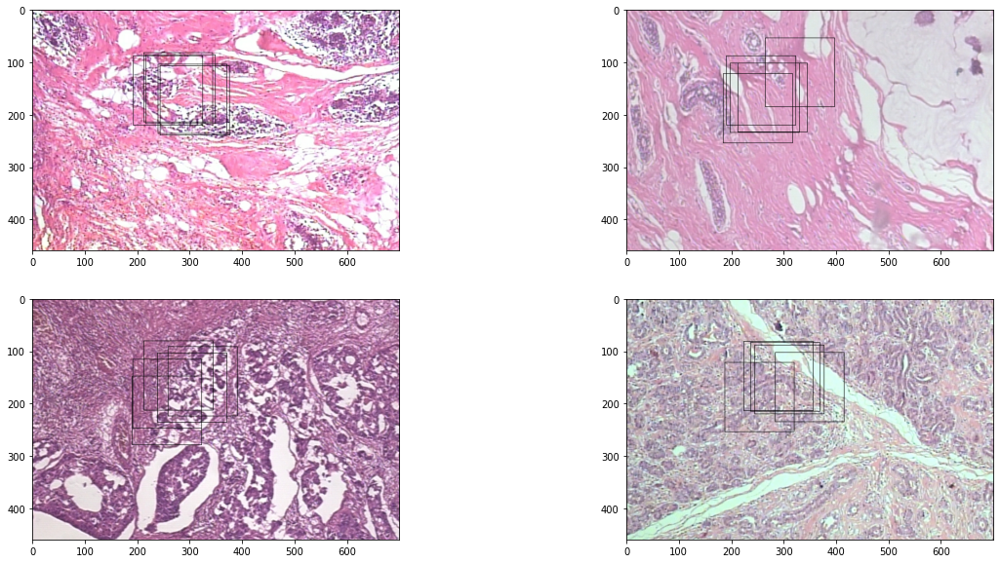

In [ ]:
for epoch in range(10, 15):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(log_probs, axis=[1, 0])*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


In [ ]:
test_iter = test_ds.as_numpy_iterator()

In [ ]:
_,_,fr,_ = the_loop(test_iter, True, test_size)

 1 Step 142:                          Val Loss 1.8725373300028518 , Val Accuracy 0.4234154929577464

### Experiment 26/9

Saved models 120 epochs, SaNet did train 33-->47%, not so good generalization. 

```
Epoch 1
 1 Step 252: Loss 1.4167722812727868 , Accuracy 0.3353174603174603
 1 Step 104:                          Val Loss 9.90010475324764 , Val Accuracy 0.4567307692307692
Epoch 2
 1 Step 252: Loss 1.529041473679837 , Accuracy 0.3521825396825396
 1 Step 104:                          Val Loss 4.304744035170259 , Val Accuracy 0.43028846153846156
Epoch 3
 1 Step 252: Loss 1.520365798659253 , Accuracy 0.3541666666666667
 1 Step 104:                          Val Loss 4.343825320963965 , Val Accuracy 0.45913461538461536
Epoch 4
 1 Step 252: Loss 1.6632714321511601 , Accuracy 0.3382936507936508
 1 Step 104:                          Val Loss 3.4249503813110858 , Val Accuracy 0.17548076923076916
Epoch 5
 1 Step 252: Loss 1.5349681016283183 , Accuracy 0.3680555555555557
 1 Step 104:                          Val Loss 3.468753189421617 , Val Accuracy 0.12980769230769232
 ```

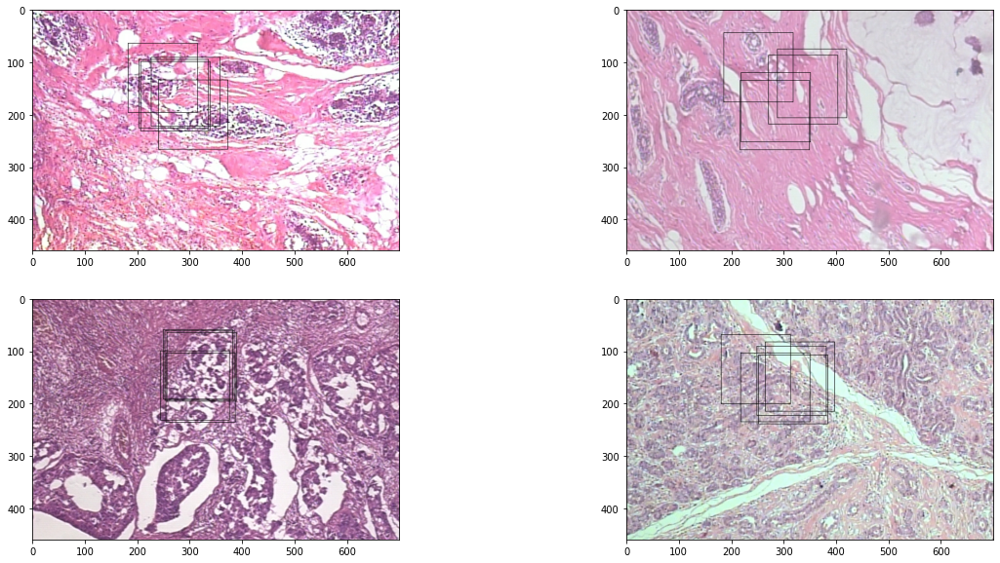

In [ ]:
show_batch(batch, positions)

Epoch 6
 1 Step 252: Loss 1.459565189546934 , Accuracy 0.37202380952380953
 1 Step 104:                          Val Loss 2.3793531323854733 , Val Accuracy 0.30528846153846145
Epoch 7
 1 Step 252: Loss 1.4371732589345247 , Accuracy 0.373015873015873
 1 Step 104:                          Val Loss 4.289139825798816 , Val Accuracy 0.46153846153846156
Epoch 8
 1 Step 252: Loss 1.5952669138288382 , Accuracy 0.3521825396825397
 1 Step 104:                          Val Loss 6.332469545724925 , Val Accuracy 0.451923076923077
Epoch 9
 1 Step 252: Loss 1.6835431401573464 , Accuracy 0.3670634920634922
 1 Step 104:                          Val Loss 2.974597394752961 , Val Accuracy 0.1754807692307692
Epoch 10
 1 Step 252: Loss 1.5558676675279874 , Accuracy 0.35714285714285715
 1 Step 104:                          Val Loss 2.280769291405495 , Val Accuracy 0.19230769230769232
Epoch 11
 1 Step 252: Loss 1.5922010097733965 , Accuracy 0.3412698412698412
 1 Step 104:                          Val Loss 2.6

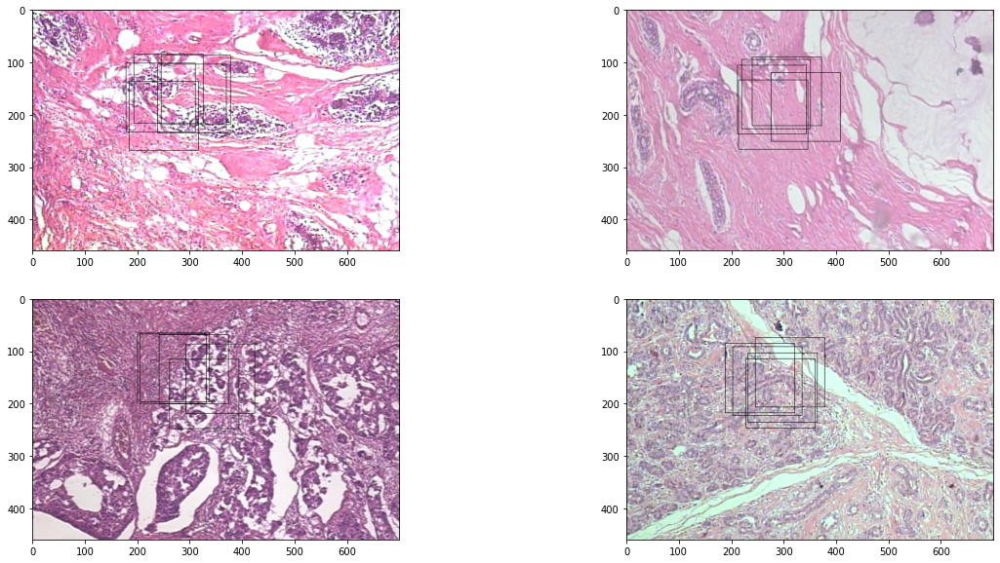

In [ ]:
for epoch in range(5, 15):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 16
 1 Step 252: Loss 1.4174711218146274 , Accuracy 0.39384920634920634
 1 Step 104:                          Val Loss 2.652351807104424 , Val Accuracy 0.4423076923076923
Epoch 17
 1 Step 252: Loss 1.374536728652726 , Accuracy 0.3978174603174603
 1 Step 104:                          Val Loss 2.8400818605978895 , Val Accuracy 0.4543269230769231
Epoch 18
 1 Step 252: Loss 1.3353732179356956 , Accuracy 0.39087301587301587
 1 Step 104:                          Val Loss 3.475006385366074 , Val Accuracy 0.49038461538461536
Epoch 19
 1 Step 252: Loss 1.4079175996067481 , Accuracy 0.36408730158730157
 1 Step 104:                          Val Loss 5.907362916950276 , Val Accuracy 0.4519230769230769
Epoch 20
 1 Step 252: Loss 1.4842337805422998 , Accuracy 0.4027777777777778
 1 Step 104:                          Val Loss 5.87159164643918 , Val Accuracy 0.45913461538461536
Epoch 21
 1 Step 252: Loss 1.5208533664440949 , Accuracy 0.3343253968253968
 1 Step 104:                          Val Los

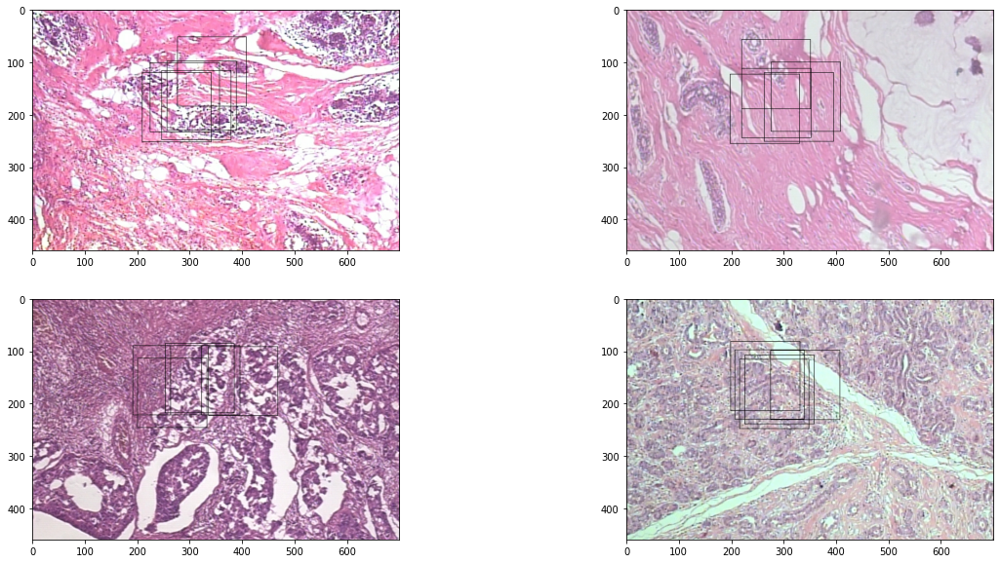

In [ ]:
for epoch in range(15, 30):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 31
 1 Step 252: Loss 1.3196415177408773 , Accuracy 0.3988095238095239
 1 Step 104:                          Val Loss 6.684751538506064 , Val Accuracy 0.2548076923076922
Epoch 32
 1 Step 252: Loss 1.2835737962224003 , Accuracy 0.4136904761904762
 1 Step 104:                          Val Loss 6.178016233616152 , Val Accuracy 0.3581730769230769
Epoch 33
 1 Step 252: Loss 1.2559310610176044 , Accuracy 0.40972222222222215
 1 Step 104:                          Val Loss 6.233723918190942 , Val Accuracy 0.4014423076923077
Epoch 34
 1 Step 252: Loss 1.2292308867023773 , Accuracy 0.4117063492063493
 1 Step 104:                          Val Loss 6.464615772836483 , Val Accuracy 0.3461538461538463
Epoch 35
 1 Step 252: Loss 1.1997291442080276 , Accuracy 0.4166666666666668
 1 Step 104:                          Val Loss 7.581614066775028 , Val Accuracy 0.2548076923076923
Epoch 36
 1 Step 252: Loss 1.2233161477789898 , Accuracy 0.4236111111111111
 1 Step 104:                          Val Loss 6

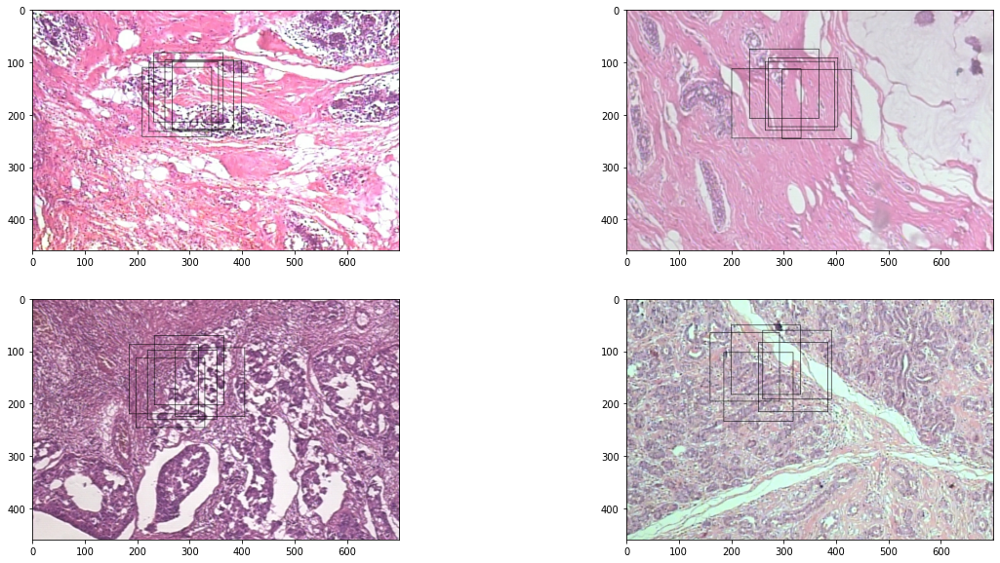

In [ ]:
for epoch in range(30, 50):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 51
 1 Step 252: Loss 1.1847664277410663 , Accuracy 0.4186507936507938
 1 Step 104:                          Val Loss 4.722698015957855 , Val Accuracy 0.37259615384615385
Epoch 52
 1 Step 252: Loss 1.1684792374771427 , Accuracy 0.4186507936507938
 1 Step 104:                          Val Loss 4.080077018203714 , Val Accuracy 0.40865384615384615
Epoch 53
 1 Step 252: Loss 1.117862250147035 , Accuracy 0.42857142857142855
 1 Step 104:                          Val Loss 3.68381267073206 , Val Accuracy 0.30769230769230765
Epoch 54
 1 Step 252: Loss 1.1112827950334856 , Accuracy 0.43749999999999994
 1 Step 104:                          Val Loss 3.5648346465940657 , Val Accuracy 0.37019230769230776
Epoch 55
 11 Step 252: Loss 1.1475766786212007 , Accuracy 0.41468253968253965
 11 Step 104:                          Val Loss 3.866373940669711 , Val Accuracy 0.40625
Epoch 56
 1 Step 252: Loss 1.157527602633063 , Accuracy 0.42261904761904756
 1 Step 104:                          Val Loss 3.574

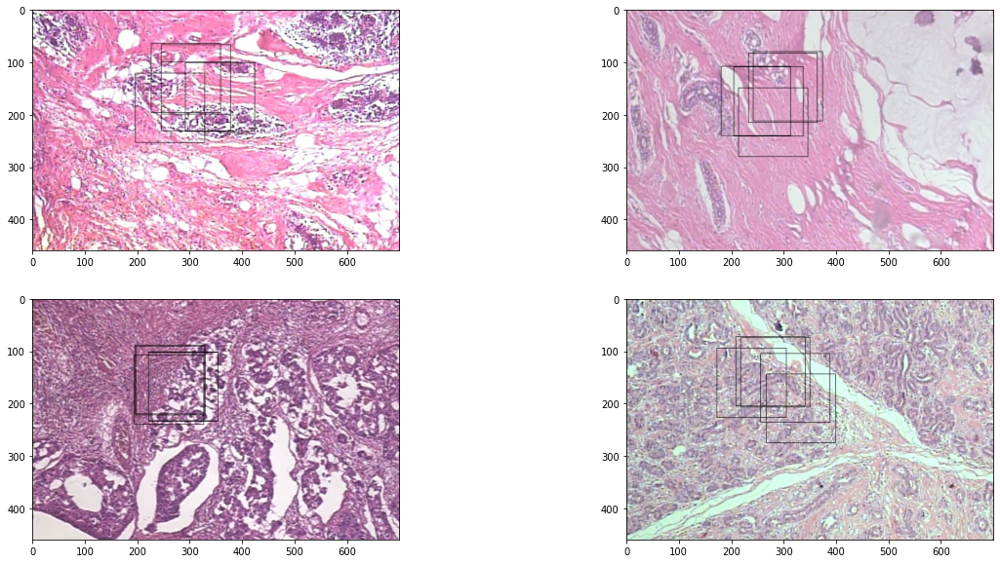

In [ ]:
for epoch in range(50, 70):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 71
 1 Step 252: Loss 1.0435670352261888 , Accuracy 0.42956349206349204
 1 Step 104:                          Val Loss 4.1688303750684454 , Val Accuracy 0.43990384615384615
Epoch 72
 1 Step 252: Loss 1.051267813834726 , Accuracy 0.43452380952380953
 1 Step 104:                          Val Loss 3.7862122330643624 , Val Accuracy 0.4206730769230769
Epoch 73
 1 Step 252: Loss 1.0479046039483713 , Accuracy 0.4543650793650793
 1 Step 104:                          Val Loss 3.864263194621835 , Val Accuracy 0.4326923076923077
Epoch 74
 1 Step 252: Loss 1.0473735033982743 , Accuracy 0.4533730158730159
 1 Step 104:                          Val Loss 3.494895673930072 , Val Accuracy 0.4038461538461539
Epoch 75
 1 Step 252: Loss 1.0291112974423062 , Accuracy 0.44543650793650785
 1 Step 104:                          Val Loss 3.57573221063313 , Val Accuracy 0.42788461538461536
Epoch 76
 1 Step 252: Loss 1.0486981702290197 , Accuracy 0.439484126984127
 1 Step 104:                          Val Los

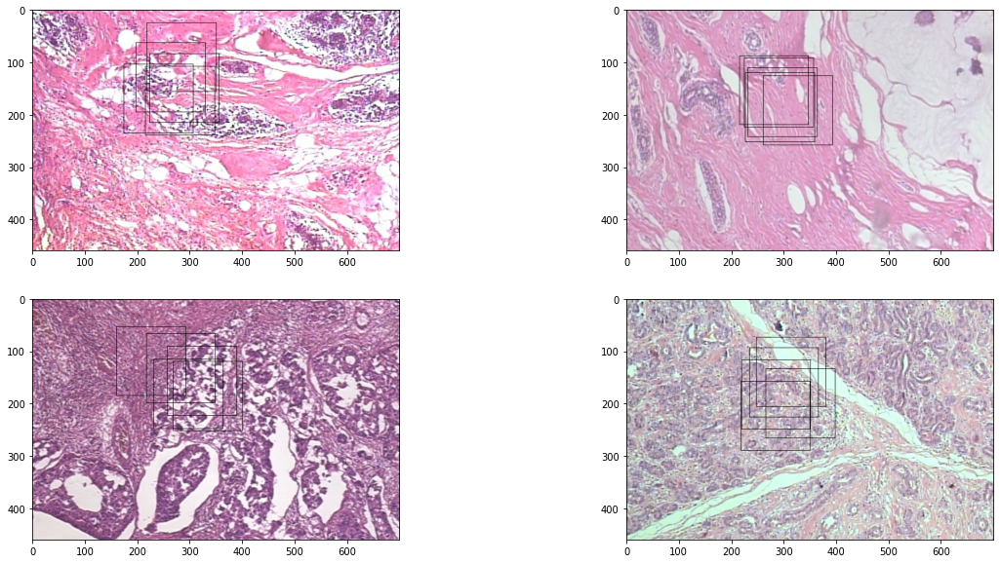

In [ ]:
for epoch in range(70, 100):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


Epoch 101
 1 Step 252: Loss 0.931312201454558 , Accuracy 0.46825396825396837
 1 Step 104:                          Val Loss 5.044783188397282 , Val Accuracy 0.38461538461538464
Epoch 102
 1 Step 252: Loss 0.9375677725411096 , Accuracy 0.47817460317460303
 1 Step 104:                          Val Loss 5.631009968069311 , Val Accuracy 0.40865384615384615
Epoch 103
 1 Step 252: Loss 0.949961249226088 , Accuracy 0.4642857142857144
 1 Step 104:                          Val Loss 4.653765932298624 , Val Accuracy 0.36778846153846156
Epoch 104
 1 Step 252: Loss 0.9334252736632143 , Accuracy 0.4623015873015873
 1 Step 104:                          Val Loss 6.170120686292648 , Val Accuracy 0.3173076923076923
Epoch 105
 1 Step 252: Loss 0.9446177167678436 , Accuracy 0.4484126984126985
 1 Step 104:                          Val Loss 6.3640769983713446 , Val Accuracy 0.3485576923076923
Epoch 106
 1 Step 252: Loss 0.9325077753438086 , Accuracy 0.4732142857142857
 1 Step 104:                          V

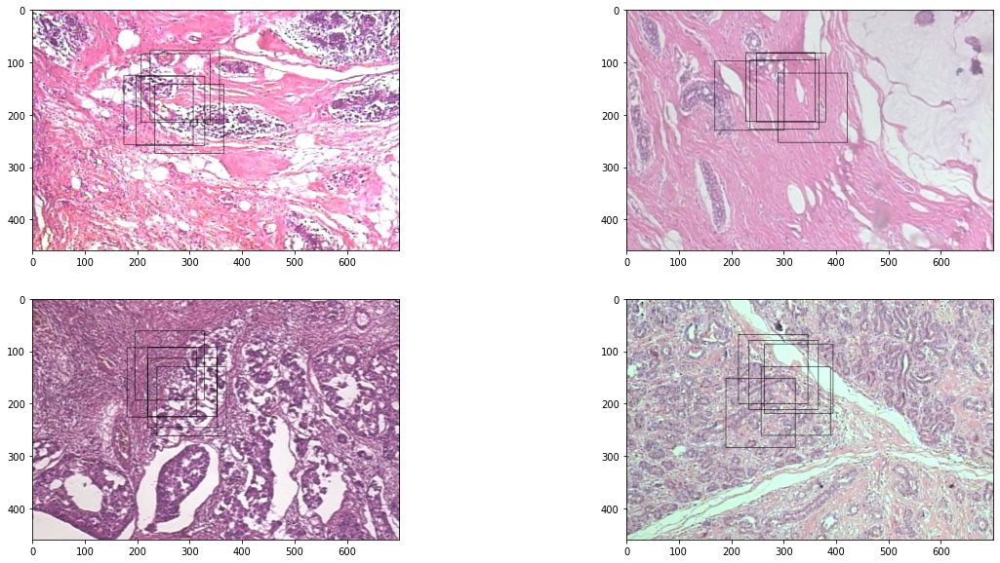

In [ ]:
for epoch in range(100, 120):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    ## code for Dense(2) x 2  
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_sum(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)


### Experiment 25/9 
Same config as 24/9 but noise=50/dim

```
Epoch 1
 1 Step 252: Loss 1.3684685696928123 , Accuracy 0.35912698412698413
 1 Step 104:                          Val Loss 10.374517702811046 , Val Accuracy 0.4567307692307692
Epoch 2
 1 Step 252: Loss 1.5369671746563618 , Accuracy 0.3541666666666667
 1 Step 104:                          Val Loss 5.845840767083607 , Val Accuracy 0.4567307692307692
Epoch 3
 1 Step 252: Loss 1.5951837076110735 , Accuracy 0.3412698412698414
 1 Step 104:                          Val Loss 3.824998480645438 , Val Accuracy 0.44471153846153844
Epoch 4
 1 Step 252: Loss 1.5572875102848867 , Accuracy 0.35714285714285715
 1 Step 104:                          Val Loss 3.1672398932278156 , Val Accuracy 0.3389423076923076
Epoch 5
 1 Step 252: Loss 1.5700362925491647 , Accuracy 0.36904761904761907
 1 Step 104:                          Val Loss 2.811896381183312 , Val Accuracy 0.40865384615384615
 ```

Epoch 6
 1 Step 252: Loss 1.585591170238331 , Accuracy 0.37698412698412687
 1 Step 104:                          Val Loss 4.892172947138466 , Val Accuracy 0.4567307692307692
Epoch 7
 1 Step 252: Loss 1.595643431201415 , Accuracy 0.3640873015873015
 1 Step 104:                          Val Loss 2.3335793316364284 , Val Accuracy 0.18509615384615385
Epoch 8
 1 Step 252: Loss 1.494024123370072 , Accuracy 0.39087301587301587
 1 Step 104:                          Val Loss 2.525215514577352 , Val Accuracy 0.2620192307692308
Epoch 9
 1 Step 252: Loss 1.4909399653214876 , Accuracy 0.37202380952380953
 1 Step 104:                          Val Loss 4.4186149942017 , Val Accuracy 0.4567307692307692
Epoch 10
 1 Step 252: Loss 1.682887488511383 , Accuracy 0.3075396825396826
 1 Step 104:                          Val Loss 3.4693376242111507 , Val Accuracy 0.43749999999999994


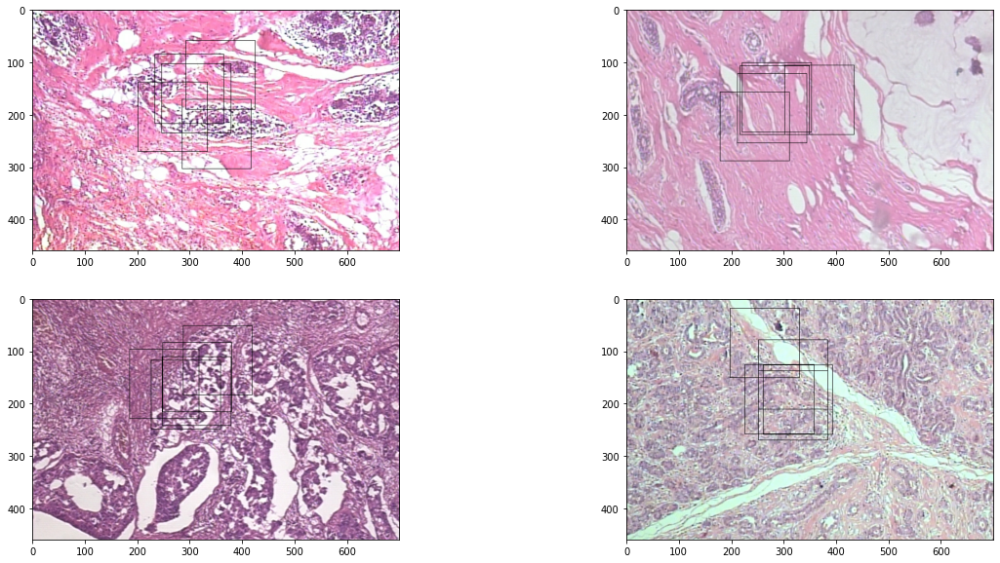

In [ ]:
for epoch in range(5,10):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 11
 1 Step 252: Loss 1.640756562492617 , Accuracy 0.3303571428571428
 1 Step 104:                          Val Loss 3.0540933327641904 , Val Accuracy 0.3629807692307692
Epoch 12
 1 Step 252: Loss 1.7059782539449988 , Accuracy 0.3035714285714285
 1 Step 104:                          Val Loss 2.9882292627142024 , Val Accuracy 0.14182692307692307
Epoch 13
 1 Step 252: Loss 1.5437105336847414 , Accuracy 0.36507936507936506
 1 Step 104:                          Val Loss 2.8458642460978947 , Val Accuracy 0.23076923076923073
Epoch 14
 1 Step 252: Loss 1.4808927510416023 , Accuracy 0.3621031746031746
 1 Step 104:                          Val Loss 2.399187399181895 , Val Accuracy 0.4567307692307692
Epoch 15
 1 Step 252: Loss 1.4941510595861711 , Accuracy 0.35912698412698413
 1 Step 104:                          Val Loss 2.0838101480442752 , Val Accuracy 0.37259615384615385
Epoch 16
 1 Step 252: Loss 1.5899061715001206 , Accuracy 0.34027777777777785
 1 Step 104:                          Va

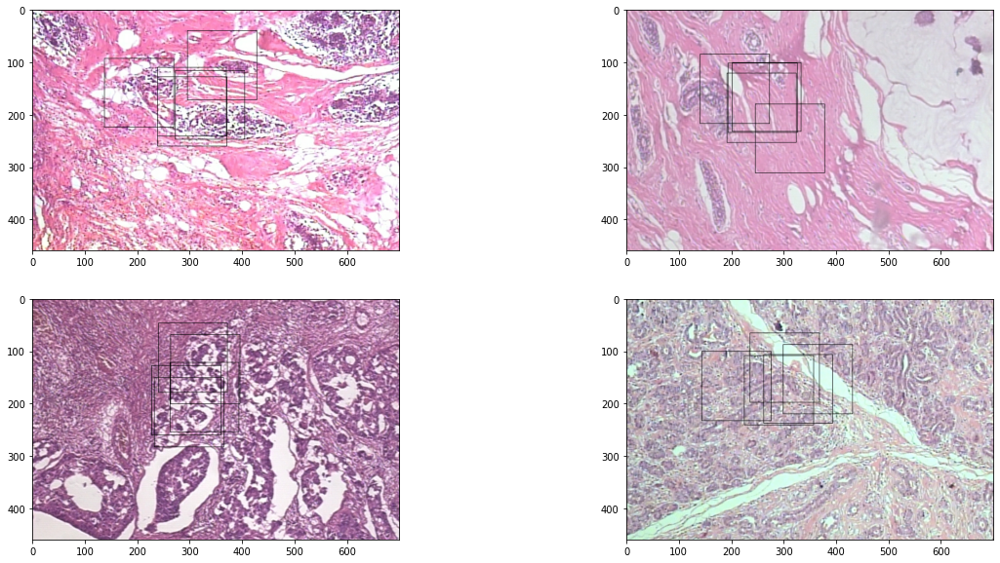

In [ ]:
for epoch in range(10,20):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 21
 1 Step 252: Loss 1.531573661137372 , Accuracy 0.3402777777777778
 1 Step 104:                          Val Loss 4.113882542390805 , Val Accuracy 0.375
Epoch 22
 1 Step 252: Loss 1.4295274043337447 , Accuracy 0.36011904761904756
 1 Step 104:                          Val Loss 7.2282247068870635 , Val Accuracy 0.4567307692307694
Epoch 23
 1 Step 252: Loss 1.4358393099611262 , Accuracy 0.36408730158730157
 1 Step 104:                          Val Loss 7.111989990306678 , Val Accuracy 0.4567307692307693
Epoch 24
 1 Step 252: Loss 1.4011719931759647 , Accuracy 0.3859126984126983
 1 Step 104:                          Val Loss 13.970410899081681 , Val Accuracy 0.4567307692307692
Epoch 25
 1 Step 252: Loss 1.3647325713268759 , Accuracy 0.3958333333333333
 1 Step 104:                          Val Loss 11.782540462313737 , Val Accuracy 0.4567307692307692
Epoch 26
 1 Step 252: Loss 1.3665248767208564 , Accuracy 0.36607142857142855
 1 Step 104:                          Val Loss 9.20122478

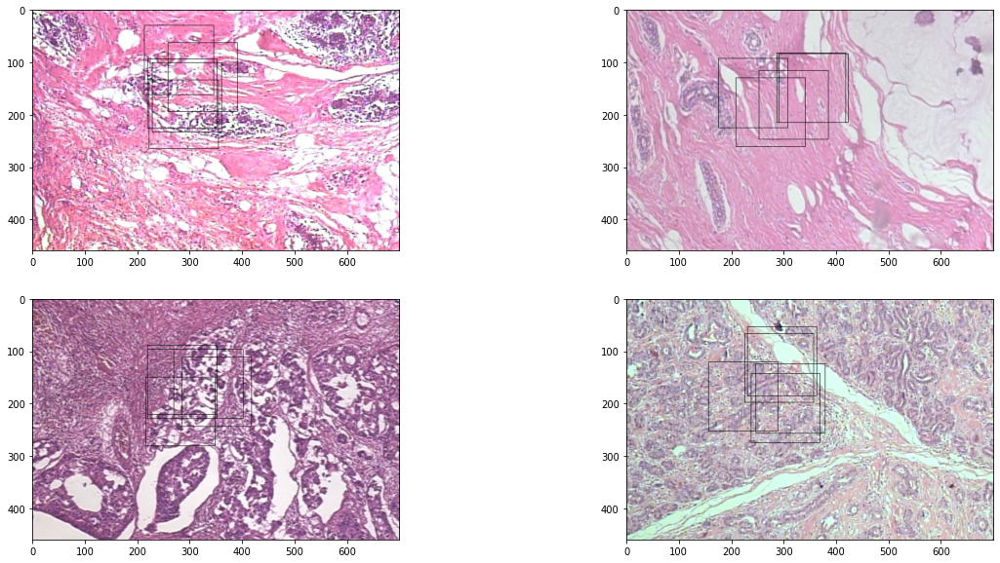

In [ ]:
for epoch in range(20,30):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

### Experiment 24/9
Very Promising ! \\


```
Epoch 1
 1 Step 252: Loss 1.3671510603205204 , Accuracy 0.37896825396825407
 1 Step 104:                          Val Loss 8.442637980027998 , Val Accuracy 0.4567307692307692
 ```

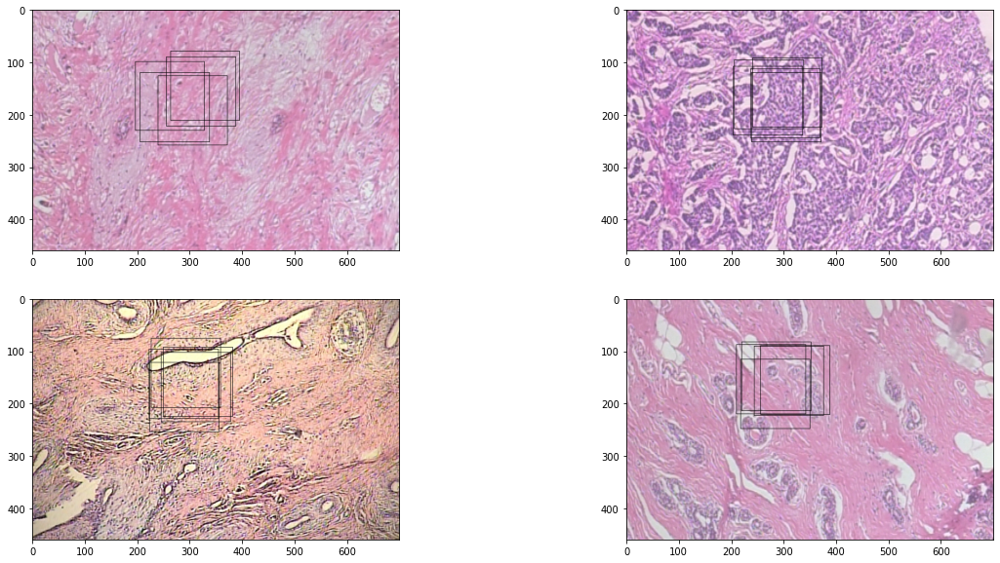

In [ ]:
show_batch(batch, positions)

Epoch 8
 1 Step 252: Loss 1.5979233988087702 , Accuracy 0.36210317460317465
 1 Step 104:                          Val Loss 4.05286009206723 , Val Accuracy 0.4495192307692308
Epoch 9
 1 Step 252: Loss 1.7403589168171743 , Accuracy 0.33035714285714296
 1 Step 104:                          Val Loss 3.8839343396248314 , Val Accuracy 0.4543269230769231
Epoch 10
 1 Step 252: Loss 1.6845194515661277 , Accuracy 0.37400793650793646
 1 Step 104:                          Val Loss 4.22339630096674 , Val Accuracy 0.4519230769230769
Epoch 11
 1 Step 252: Loss 1.6417191652174559 , Accuracy 0.373015873015873
 1 Step 104:                          Val Loss 3.2951779780739274 , Val Accuracy 0.4543269230769231
Epoch 12
 1 Step 252: Loss 1.6336127516983574 , Accuracy 0.3462301587301588
 1 Step 104:                          Val Loss 1.951546959578991 , Val Accuracy 0.29567307692307704
Epoch 13
 1 Step 252: Loss 1.5669635434497304 , Accuracy 0.4047619047619049
 1 Step 104:                          Val Loss 5

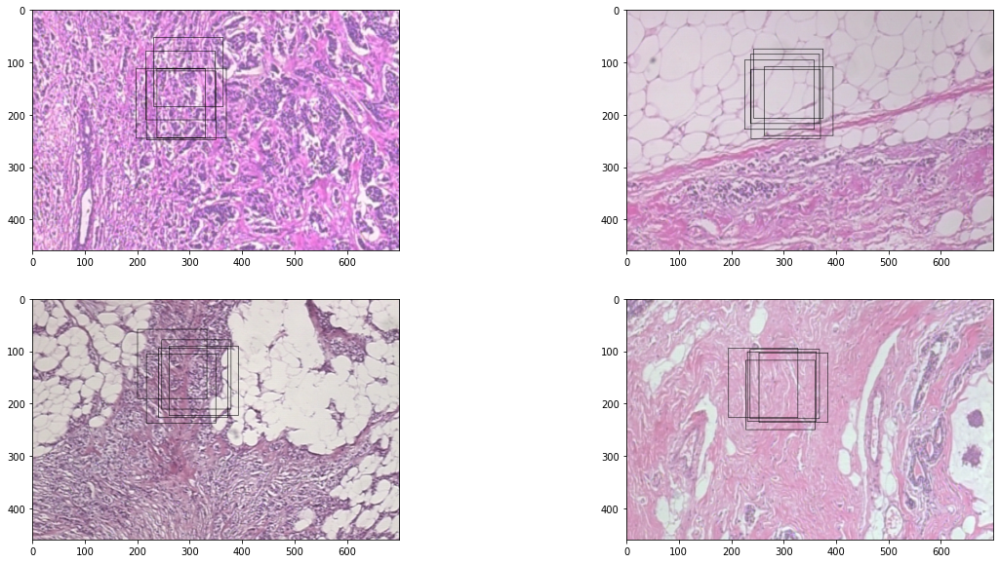

In [ ]:
for epoch in range(7,20):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 21
 1 Step 252: Loss 1.554435955419663 , Accuracy 0.3978174603174601
 1 Step 104:                          Val Loss 4.397467802146613 , Val Accuracy 0.42788461538461536
Epoch 22
 1 Step 252: Loss 1.5279075957355213 , Accuracy 0.41369047619047633
 1 Step 104:                          Val Loss 5.3956554100956335 , Val Accuracy 0.4519230769230769
Epoch 23
 1 Step 252: Loss 1.5057773743830019 , Accuracy 0.3630952380952382
 1 Step 104:                          Val Loss 5.426020016429588 , Val Accuracy 0.4567307692307692
Epoch 24
 1 Step 252: Loss 1.490618716812663 , Accuracy 0.37797619047619047
 1 Step 104:                          Val Loss 6.602925824294011 , Val Accuracy 0.45913461538461536
Epoch 25
 1 Step 252: Loss 1.4391949821008547 , Accuracy 0.39087301587301587
 1 Step 104:                          Val Loss 6.636842353427887 , Val Accuracy 0.4567307692307693
Epoch 26
 1 Step 252: Loss 1.4163425940057517 , Accuracy 0.3968253968253968
 1 Step 104:                          Val Los

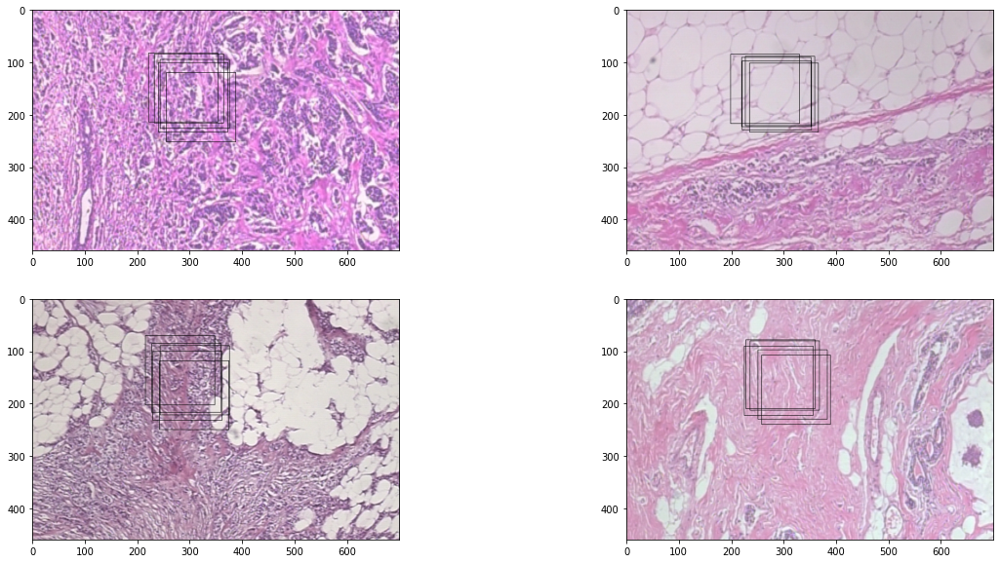

In [ ]:
for epoch in range(20,40):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 41
 1 Step 252: Loss 1.3411502505607333 , Accuracy 0.40376984126984117
 1 Step 104:                          Val Loss 7.458880673524758 , Val Accuracy 0.44711538461538464
Epoch 42
 1 Step 252: Loss 1.3787114263042375 , Accuracy 0.39285714285714296
 1 Step 104:                          Val Loss 8.851335234653487 , Val Accuracy 0.3798076923076924
Epoch 43
 1 Step 252: Loss 1.3510906987750555 , Accuracy 0.39087301587301587
 1 Step 104:                          Val Loss 8.694076866305503 , Val Accuracy 0.3798076923076922
Epoch 44
 1 Step 252: Loss 1.3443541458996369 , Accuracy 0.4037698412698413
 1 Step 104:                          Val Loss inf , Val Accuracy 0.44711538461538464
Epoch 45
 1 Step 252: Loss 1.348752390823811 , Accuracy 0.4206349206349206
 1 Step 104:                          Val Loss inf , Val Accuracy 0.45913461538461536
Epoch 46
 1 Step 252: Loss 1.295882063191606 , Accuracy 0.40575396825396826
 1 Step 104:                          Val Loss 9.09766485395644 , Val Ac

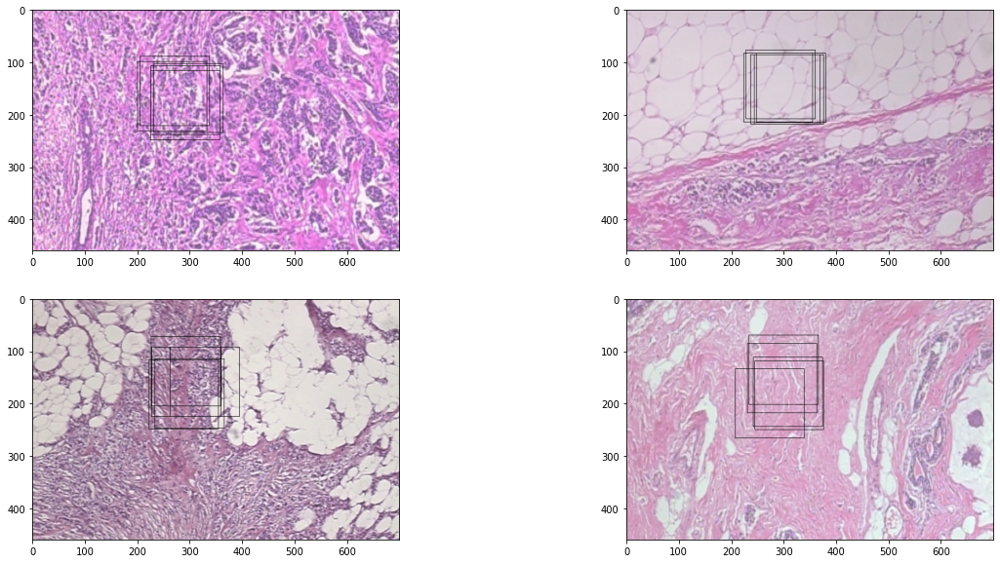

In [ ]:
for epoch in range(40,50):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 51
 1 Step 252: Loss 1.2379826753019607 , Accuracy 0.41369047619047616
 1 Step 104:                          Val Loss 4.206910589566601 , Val Accuracy 0.40384615384615385
Epoch 52
 1 Step 252: Loss 1.2677353836673622 , Accuracy 0.40079365079365076
 1 Step 104:                          Val Loss 3.0088493124796796 , Val Accuracy 0.3173076923076923
Epoch 53
 1 Step 252: Loss 1.2700899886521733 , Accuracy 0.4236111111111112
 1 Step 104:                          Val Loss 3.9372240876635685 , Val Accuracy 0.21153846153846154
Epoch 54
 1 Step 252: Loss 1.268920745939203 , Accuracy 0.42658730158730157
 1 Step 104:                          Val Loss 3.199885394424199 , Val Accuracy 0.26682692307692324
Epoch 55
 1 Step 252: Loss 1.2253703404310814 , Accuracy 0.40873015873015883
 1 Step 104:                          Val Loss 3.1545956570368547 , Val Accuracy 0.21634615384615385
Epoch 56
 1 Step 252: Loss 1.2467266165643065 , Accuracy 0.4156746031746032
 1 Step 104:                          V

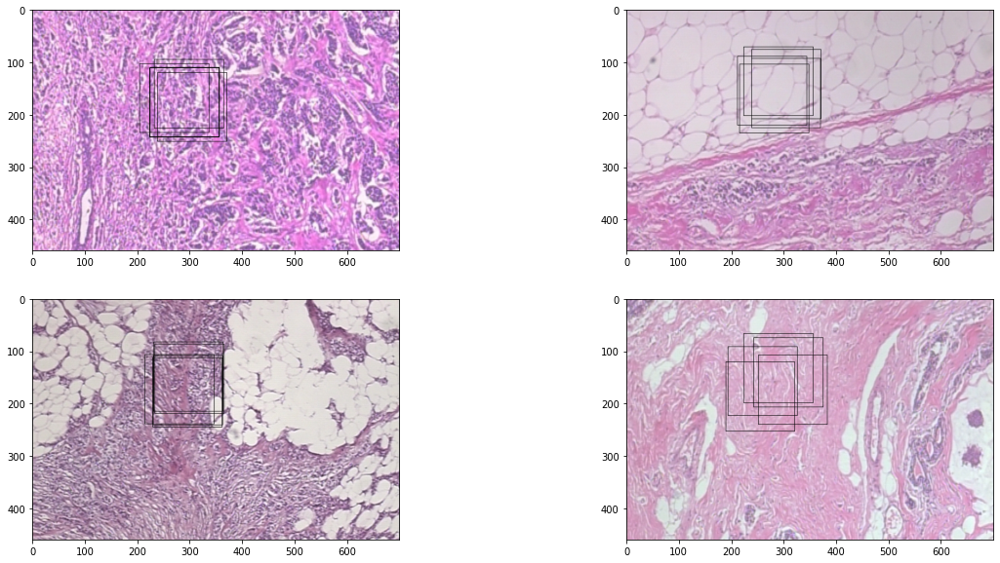

In [ ]:
for epoch in range(50,60):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

In [ ]:
for epoch in range(60,80):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input

  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    for i,o in enumerate(outputs):
      tmp = [tf.reshape(t, [4,5,1]) for t in tf.unstack(o[1], axis=-1)]
      outputs[i] = tf.squeeze(tf.stack([o[0], tmp[0], tmp[1]], axis=-1))
    # actions, locs = tf.unstack(outputs, axis=1)
    # log_probs = tf.keras.backend.log(tf.cast(tf.concat([actions, locs], axis=-1), 'float64'))
    log_probs = tf.keras.backend.log(outputs)
    policy_loss = -tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)



  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)
show_batch(batch, positions)

Epoch 61
 1 Step 252: Loss 1.1544543326084433 , Accuracy 0.42261904761904756
 1 Step 104:                          Val Loss 3.1247280452113886 , Val Accuracy 0.4543269230769231
Epoch 62
 1 Step 252: Loss 1.1660050594419733 , Accuracy 0.41964285714285726
 1 Step 104:                          Val Loss 2.8828544915517202 , Val Accuracy 0.3581730769230769
Epoch 63
 1 Step 252: Loss 1.1460669873128018 , Accuracy 0.4156746031746032
 1 Step 104:                          Val Loss 2.7881149788781134 , Val Accuracy 0.40625
Epoch 64
 1 Step 252: Loss 1.147960921770723 , Accuracy 0.4166666666666668
 1 Step 104:                          Val Loss 3.1712375566040953 , Val Accuracy 0.3918269230769231
Epoch 65
 11 Step 252: Loss 1.1301349495303827 , Accuracy 0.4365079365079366
 11 Step 104:                          Val Loss 2.9518572200949373 , Val Accuracy 0.4375
Epoch 66
 11 Step 30: Loss 1.0811696887870008 , Accuracy 0.6083333333333333

In [ ]:
# !mkdir models
tf.keras.models.save_model(De_Net, 'DeNet/') #120 epochs
tf.keras.models.save_model(SA_Net, 'SaNet/') #120 epochs
# !du -h models
# !rm -r models


INFO:tensorflow:Assets written to: DeNet/assets
INFO:tensorflow:Assets written to: SaNet/assets


In [ ]:
cp -r SaNet drive/My\ Drive/

### Experiment 23/9

In [ ]:
for epoch in range(5,10):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input
  
  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    actions, locs = tf.unstack(outputs, axis=1)
    log_probs = tf.keras.backend.log(tf.cast(tf.concat([tf.reduce_max(actions, axis=-1, keepdims=True), locs], axis=-1), 'float64'))
    policy_loss = tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)

  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)

Epoch 6
 1 Step 252: Loss 1.5979216848795743 , Accuracy 0.35714285714285726
 1 Step 104:                          Val Loss 3.2124004719763226 , Val Accuracy 0.4567307692307692
Epoch 7
 1 Step 252: Loss 1.6593668824135668 , Accuracy 0.3125
 1 Step 104:                          Val Loss 1.9003735671822841 , Val Accuracy 0.2788461538461538
Epoch 8
 1 Step 252: Loss 1.636147452437038 , Accuracy 0.3521825396825397
 1 Step 104:                          Val Loss 2.727944295029514 , Val Accuracy 0.298076923076923
Epoch 9
 1 Step 252: Loss 1.5908082891292583 , Accuracy 0.36111111111111105
 1 Step 104:                          Val Loss 2.4104295881250164 , Val Accuracy 0.4567307692307692
Epoch 10
 1 Step 252: Loss 1.6125301060688104 , Accuracy 0.35119047619047616
 1 Step 104:                          Val Loss 2.337355289178398 , Val Accuracy 0.4543269230769231


In [ ]:
for epoch in range(40,50):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ , hist_loss= the_loop(train_iter, False, train_size, historical_loss=0. if not epoch else hist_loss)
  
  print()

  _,__,reward,_ = the_loop(val_iter,  True, val_size)
# update DeNet for every input
  
  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    actions, locs = tf.unstack(outputs, axis=1)
    log_probs = tf.keras.backend.log(tf.cast(tf.concat([tf.reduce_max(actions, axis=-1, keepdims=True), locs], axis=-1), 'float64'))
    policy_loss = tf.math.reduce_sum(tf.reduce_mean(log_probs, axis=1), axis=0)*(reward-hist_rew)

  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  # grads = tuple(tf.clip_by_norm(g, 5.) for g in grads)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()
  hist_rew = (hist_rew*epoch+reward)/(epoch+1)

Epoch 41
 1 Step 252: Loss 1.2760489792535303 , Accuracy 0.39087301587301587
 1 Step 104:                          Val Loss 13.513176000318849 , Val Accuracy 0.43990384615384615
Epoch 42
 1 Step 252: Loss 1.2365496167931558 , Accuracy 0.40079365079365076
 1 Step 104:                          Val Loss 12.821436723765846 , Val Accuracy 0.44471153846153844
Epoch 43
 1 Step 252: Loss 1.2053872596297879 , Accuracy 0.39186507936507936
 1 Step 104:                          Val Loss inf , Val Accuracy 0.4519230769230769
Epoch 44
 1 Step 252: Loss 1.233161713463709 , Accuracy 0.375
 1 Step 104:                          Val Loss 13.408085120490519 , Val Accuracy 0.4567307692307692
Epoch 45
 1 Step 252: Loss 1.245780592040059 , Accuracy 0.3898809523809524
 1 Step 104:                          Val Loss 10.868601886478315 , Val Accuracy 0.4519230769230769
Epoch 46
 1 Step 252: Loss 1.178435797637951 , Accuracy 0.3898809523809525
 1 Step 104:                          Val Loss inf , Val Accuracy 0.41

### Old Experiment

In [ ]:
# Older version for zoom 100 in which the first 5 patches where selected during validation (action was ignored)
for epoch in range(20, 41 ):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ = the_loop(train_iter, False, train_size)
  
  print()

  _,__,reward = the_loop(val_iter,  True, val_size)


  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    log_probs = tf.transpose(tf.reshape(tf.nn.log_softmax(outputs), (len(outputs)*20, 3)))
    policy_loss = -tf.math.reduce_mean(log_probs*reward, axis=1)

  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()

Epoch 21
 Step 292: Loss 1.8536320385867602 , Accuracy 0.4203767123287671
 Step 90:                          Val Loss 1.743453195359972 , Val Accuracy 0.5305555555555554
Epoch 22
 Step 292: Loss 1.857056696121007 , Accuracy 0.4169520547945206
 Step 90:                          Val Loss 1.7462309731377497 , Val Accuracy 0.5277777777777779
Epoch 23
 Step 292: Loss 1.8484950522853905 , Accuracy 0.4255136986301369
 Step 90:                          Val Loss 1.740675417582194 , Val Accuracy 0.5333333333333338
Epoch 24
 Step 292: Loss 1.8647621755730617 , Accuracy 0.4092465753424656
 Step 90:                          Val Loss 1.7184531953599718 , Val Accuracy 0.5555555555555556
Epoch 25
 Step 292: Loss 1.8544882029703202 , Accuracy 0.4195205479452053
 Step 90:                          Val Loss 1.7295643064710828 , Val Accuracy 0.5444444444444443
Epoch 26
 Step 292: Loss 1.8536320385867606 , Accuracy 0.4203767123287671
 Step 90:                          Val Loss 1.743453195359972 , Val Accura

In [ ]:
for epoch in range(40, 81 ):
  print(f"Epoch {epoch+1}")
  deeps,shallows,_ = the_loop(train_iter, False, train_size)
  
  print()

  _,__,reward = the_loop(val_iter,  True, val_size)


  with tf.GradientTape() as policy_tape:

    outputs = [De_Net([d,o]) for d,o in zip(deeps,shallows)]
    log_probs = tf.transpose(tf.reshape(tf.nn.log_softmax(outputs), (len(outputs)*20, 3)))
    policy_loss = -tf.math.reduce_mean(log_probs*reward, axis=1)

  policy_variables = De_Net.trainable_variables
  grads = policy_tape.gradient(policy_loss, policy_variables)
  De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
  print()

Epoch 41
 Step 292: Loss 1.8570566961210069 , Accuracy 0.4169520547945206
 Step 90:                          Val Loss 1.743453195359972 , Val Accuracy 0.5305555555555557
Epoch 42
 Step 292: Loss 1.8596251892716908 , Accuracy 0.4143835616438355
 Step 90:                          Val Loss 1.7378976398044161 , Val Accuracy 0.5361111111111111
Epoch 43
 Step 292: Loss 1.8502073810525144 , Accuracy 0.42380136986301353
 Step 90:                          Val Loss 1.7378976398044161 , Val Accuracy 0.5361111111111108
Epoch 44
 Step 292: Loss 1.8519197098196385 , Accuracy 0.4220890410958904
 Step 90:                          Val Loss 1.7351198620266384 , Val Accuracy 0.5388888888888889
Epoch 45
 Step 292: Loss 1.8621936824223766 , Accuracy 0.4118150684931506
 Step 90:                          Val Loss 1.743453195359972 , Val Accuracy 0.5305555555555554
Epoch 46
 Step 292: Loss 1.851919709819638 , Accuracy 0.42208904109589046
 Step 90:                          Val Loss 1.7240087509155273 , Val Acc

## Implementation with tf.environment 

DeNet--> Agent, SaNet-->Environment = Big overhead, too slow


In [ ]:
!sudo pip install tf-agents
# from tf_agents.environments import py_environment
# from tf_agents.environments import tf_environment
# from tf_agents.environments import tf_py_environment
# from tf_agents.environments import utils
# from tf_agents import specs 
# from tf_agents.environments import wrappers
# from tf_agents.environments import suite_gym
# from tf_agents.trajectories import time_step as ts
# from tf_agents.utils import common

In [ ]:
train_iter = train_ds.unbatch().batch(1).as_numpy_iterator()

In [ ]:
val_iter = val_ds.unbatch().batch(4).as_numpy_iterator()


In [ ]:

def evaluation(init_state):
  def make_val_batch_glimpses(x,y,state):
    for i in range(5):
      locations = get_actions(state).tolist() 
      glimpse =  tf.image.extract_glimpse(x, size=(112,112), offsets=locations, centered=False, normalized=False)
      tmp_batch = (glimpse, y) if not i else (tf.concat([tmp_batch[0],glimpse], 0), np.append(tmp_batch[1], y))
      
      preds = SA_Net(glimpse)
      features = SA_Net_features(glimpse)
      # predictions to labels
      preds = list(np.argmax(preds, axis=1)) 
      
      # update state
      for i, pred in enumerate(preds):
        state[i]['pred_label'] = pred
        state[i]['true_label'] = y[i] # array index = 0 first item in batch
        state[i]['loc_y'] = locations[i][0]
        state[i]['loc_x'] = locations[i][1]       
        state[i]['deep_features'] = features[i].numpy()
    return tmp_batch

  val_acc = []
  val_loss = []

  for i in range(5):
    x0,y0 = val_iter.next()
    x,y = make_val_batch_glimpses(x0,y0,the_env.val_batch)
    vl, va = SA_Net.test_on_batch(x,y)
    val_acc.append(va)
    val_loss.append(vl)
    # sys.stdout.write(f"\r{i}/{val_size//4}")
    # sys.stdout.flush()

  val_loss = np.array(val_loss)
  igamma = np.argwhere( val_loss < .25)
  acc = np.mean(val_acc)
  los = np.mean(val_loss)
  print(f'Val Loss: {los} -- Val Acc: {acc}')
  return igamma[0][0] if igamma.size else 0., acc

In [ ]:
def get_action(observation, network=De_Net, first=False):
  deep_inp = np.array(observation['deep_features']).reshape(1, 1,128)
  stats = np.array([v for k,v in observation.items() if k!='deep_features']).reshape(1, 1,7)
  deep_inp_tensor = tf.convert_to_tensor(deep_inp)
  stats_tensor = tf.convert_to_tensor(stats)

  net_output = network([deep_inp_tensor, stats_tensor])
  output = np.vstack([tf.math.argmax(logits, axis=-1)for logits in  net_output]).T[0]
  loc =  tf.round(tf.random.normal([2], np.mean((output[1:]+112).tolist()),np.sqrt(112)))

  action = [1 if first else output[0] , loc.numpy()]
  return action, net_output


In [ ]:
def get_actions(observations, network=De_Net ):
  deep_inp =  np.array([observation['deep_features'] for observation in observations]).reshape(4, 1,128)
  stats =  np.array([v for observation in observations for k,v in observation.items()  if k!='deep_features']).reshape(4,1,7)
  deep_inp_tensor = tf.convert_to_tensor(deep_inp)
  stats_tensor = tf.convert_to_tensor(stats)
  output = network([deep_inp_tensor, stats_tensor])
  output = np.vstack([tf.math.argmax(logits, axis=-1).numpy() for logits in  output]).T
  # locs =  tf.round(tf.random.normal([2], np.mean((output[1:]+112).tolist()),np.sqrt(112)))

  return output[:, 1:]+112

In [ ]:
def get_input(observations):
  # n = len(observations)
  deep_inp =  np.array([observation['deep_features'] for observation in observations]).reshape(4, 1,128)
  stats =  np.array([v for observation in observations for k,v in observation.items()  if k!='deep_features']).reshape(4,1,7)
  deep_inp_tensor = tf.convert_to_tensor(deep_inp)
  stats_tensor = tf.convert_to_tensor(stats)
  return [ deep_inp_tensor, stats_tensor]

In [ ]:

def validation(init_state):
  def make_val_batch_glimpses(x,y,state):
    for i in range(5):
      locations = get_actions(state).tolist() 
      glimpse =  tf.image.extract_glimpse(x, size=(112,112), offsets=locations, centered=False, normalized=False)
      tmp_batch = (glimpse, y) if not i else (tf.concat([tmp_batch[0],glimpse], 0), np.append(tmp_batch[1], y))
      
      preds = SA_Net(glimpse)
      features = SA_Net_features(glimpse)
      # predictions to labels
      preds = list(np.argmax(preds, axis=1)) 
      
      # update state
      for i, pred in enumerate(preds):
        state[i]['pred_label'] = pred
        state[i]['true_label'] = y[i] # array index = 0 first item in batch
        state[i]['loc_y'] = locations[i][0]
        state[i]['loc_x'] = locations[i][1]       
        state[i]['deep_features'] = features[i].numpy()
    return tmp_batch

  val_acc = []
  val_loss = []

  for i in range(val_size//4):
    x0,y0 = val_iter.next()
    x,y = make_val_batch_glimpses(x0,y0,the_env.val_batch)
    vl, va = SA_Net.test_on_batch(x,y)
    val_acc.append(va)
    val_loss.append(vl)
    sys.stdout.write(f"\r{i+1}/{val_size//4}")
    sys.stdout.flush()

  val_loss = np.array(val_loss)
  igamma = np.argwhere( val_loss < .25)
  acc = np.mean(val_acc)
  los = np.mean(val_loss)
  print(f'Val Loss: {los} -- Val Acc: {acc}')
  return igamma[0][0] if igamma.size else 0., acc

In [ ]:
from collections import deque
FIRST = ts.StepType.FIRST
MID = ts.StepType.MID
LAST = ts.StepType.LAST

class BreakHisEnv(py_environment.PyEnvironment):

  def __init__(self,iter=train_iter, network=SA_Net, features_exctractor=SA_Net_features):
    

    
     
    action_spec = specs.ArraySpec((3, ), dtype=np.uint32, name='action')
    observation_spec = specs.ArraySpec(shape=(135,), dtype=np.float32, name='observation')
    time_step_spec = ts.time_step_spec(observation_spec)

    self.iter = iter
    self._network = network
    self._feature_extractor = features_exctractor
    keys = ['avg_loss', 'max_acc', 'num_iters', 'pred_label', 'true_label', 'loc_y', 'loc_x', 'deep_features']
    vals = [0. for _ in range(7)] 
    vals.append([0. for _ in range(128)])
    self._state = {k:v for k,v in zip(keys, vals)}
    self.cropped = 0
    self.steps = 0
    self.accs = []
    self._cur_train_batch = self.iter.next()
    self.val_batch = deque()
    self.val_cnt =  0
    self.tr_steps = 0

  def action_spec(self):
    return self._action_spec

  def observation_spec(self):
    return self._observation_spec

  def curr_ts(self):
    step_type = MID if self.steps else FIRST
    reward = 0.
    if self.cropped == 20 or self.steps == 20:
      # episode ended must train SA_Net

      loss, acc = self._network.train_on_batch(self._cur_batch[0], tf.convert_to_tensor(self._cur_batch[1], dtype=tf.uint8))
      # validate
      self.tr_steps +=1

      print(f'Step {self.tr_steps} Loss: {loss}, Accuracy: {acc}')
      self.accs.append(acc)
      # val_acc = get_val_acc(get_actions(list(self.val_batch)), self.val_batch)
      igamma, val_acc = validation(the_env.val_batch)

      # update learning status representation
      self._state['avg_loss'] = (self._state['avg_loss']*self._state['num_iters'] + loss) / (self._state['num_iters'] + 1)
      self._state['max_acc'] = max(self._state['max_acc'], val_acc)
      self._state['num_iters'] +=1

      # set reward
      # preds = self._network.predict(val_set)
      # val_losses = tf.keras.loss.tf.keras.losses.SparseCategoricalCrossentropy()(val_set, preds)
      # igamma = np.argwhere(val_losses < .25)
      # rc = -np.log(igamma/200)
      reward = val_acc #+ rc    
      step_type = LAST
    
    return ts.TimeStep(step_type, reward,  0.,self._state)

  def _reset(self):
    self.cropped = 0 
    self.steps = 0
    return self.curr_ts()

  def _step(self, action):
    self.steps+=1
    

    if not (self.cropped%5):
      self._cur_train_batch = self.iter.next()

    location = action[1] 
    # fill batch for training when episode is ended
    curr_glimpse = (tf.image.extract_glimpse(self._cur_train_batch[0], size=(112,112), offsets=[location], centered=False, normalized=False), self._cur_train_batch[1])
    if action[0] :
      self._cur_batch = curr_glimpse if not (self.cropped%20) else (tf.concat([self._cur_batch[0],curr_glimpse[0]], 0), np.append(self._cur_batch[1], curr_glimpse[1]))
      self.cropped+=1
    

    # update incoming data statictics

    # print('predict ')
    pred = self._network.predict(curr_glimpse[0])
    # predictions to labels
    pred = list(np.argmax(pred, axis=1))      
    self._state['pred_label'] = pred[0]
    self._state['true_label'] = curr_glimpse[1][0] # array index = 0 first item in batch
    self._state['loc_y'] = location[0]
    self._state['loc_x'] = location[1]


    # print('features')
    features = self._feature_extractor.predict(curr_glimpse[0], steps=1)
    self._state['deep_features'] = features.reshape(1,128)
  
    self.val_batch.append(self._state)

    if len(self.val_batch)==5:
      self.val_batch.popleft()


    if action[0]>1:
      raise ValueError('`action` should be 0 or 1.')
    
    return self.curr_ts()









      


In [ ]:
class ValEnvironment(BreakHisEnv):
  def __init__(self, initial_state):
    super().__init__(iter=val_iter)
    self._state = initial_state
    self.acc = 0.0
    # self.batched_state = self._state
  
  def curr_ts(self):
    step_type = MID if self.steps else FIRST
    reward = 0.
    if self.steps== (5*(val_size // 4)) :
      

      _, val_acc = self._network.evaluate(self._cur_batch[0].numpy() , self._cur_batch[1], steps=val_size//4, batch_size=5)
      # self.acc = (self.acc*self._state['num_iters'] + val_acc) / (self._state['num_iters'] + 1)
      self.acc = val_acc
      step_type = LAST
      # self.cropped = 0
    
    return ts.TimeStep(step_type,self.acc,  0.,self._state) 
  
  def _step(self, action):
  #  action is always 1
    self.steps+=1
   

    if not (self.cropped%5):
      self._cur_train_batch = self.iter.next()
    # batched action
    locations = action.tolist() 
    # fill batch for training when episode is ended
    curr_glimpse = tf.image.extract_glimpse(self._cur_train_batch[0], size=(112,112), offsets=locations, centered=False, normalized=False)
    self._cur_batch = (curr_glimpse, self._cur_train_batch[1]) if  self.steps == 1 else (tf.concat([self._cur_batch[0],curr_glimpse], 0), np.append(self._cur_batch[1],self._cur_train_batch[1]))
    self.cropped+=1

    # update incoming data statictics

    # print('predict ')
    preds = self._network(curr_glimpse)
    features = self._feature_extractor(curr_glimpse)
    # predictions to labels
    preds = list(np.argmax(preds, axis=1)) 
    # self.batched_state = []     
    for i, pred in enumerate(preds):
      self._state[i]['pred_label'] = pred
      self._state[i]['true_label'] = self._cur_train_batch[1][i] # array index = 0 first item in batch
      self._state[i]['loc_y'] = locations[i][0]
      self._state[i]['loc_x'] = locations[i][1]


      # print('features')
      self._state[i]['deep_features'] = features[i].numpy()
      # self.batched_state.append(self._state)
    
    return self.curr_ts()

In [ ]:
import sys 
def get_val_acc(actions, init_obs):
  val_env = ValEnvironment(init_obs)
  val_env.reset()
  for i in range(val_size//4):
    for _ in range(5):
      timestep = val_env.step(actions)
      actions =  get_actions(timestep.observation)
    sys.stdout.write(f"\r{i}/{val_size//4}")
    sys.stdout.flush()
  return timestep.reward

In [ ]:
the_env._cur_batch[1]

array([5, 5, 5, 5, 5, 0])

In [ ]:
%%time 
get_val_acc(actions, obs)

91/91 [==============================] - 22s 240ms/step - loss: 86943.3281 - accuracy: 0.4753
90/91CPU times: user 1min 36s, sys: 11.9 s, total: 1min 48s
Wall time: 1min 48s


0.4752747118473053

In [ ]:
%%time 
first = True
the_env = BreakHisEnv()
for i in range(1):
  the_env.tr_steps = 0
  print(f'Epoch {i}')
  for j in range(1):
    tst = the_env.reset()
    actions = []
    states = []
    logits_list = []

    while tst.step_type!= LAST:
      action, _ = get_action(tst.observation, first=first)
      actions.append(action)
      # logits_list.append(logits)
      states.append(tst.observation)
      tst = the_env.step(action)
    reward = tst.reward
    first = False
    actions = np.array(actions)
    select = actions[:, 0]
    lx = np.array([ l[0] for l in actions[:,1]])
    ly = np.array([ l[1] for l in actions[:,1]])
    acts = [select, lx, ly]
    actions_space = [2, 236, 476]


# with tf.GradientTape() as policy_tape:
#   outputs = [ De_Net(get_input(states[i:i+4])) for i in range(0, len(states), 4) ]
#   t = [ np.array([tf.unstack(a)  for a in output]).T for output in outputs]
#   logits = np.array([ [tf.nn.log_softmax(a) for a in o] for out in t for o in out ])

#   # logits = [[ tf.nn.log_softmax(b) for b in a]  for a in logits_list]
#   one_hot = [tf.one_hot(a, n) for a,n in zip(acts, actions_space)]

#   log_probs = [ tf.math.reduce_sum(tf.stack(l)* o, axis=1) for l, o in zip(logits.T, one_hot)]

#   policy_loss = -tf.math.reduce_mean(log_probs* tf.stop_gradient(reward), axis = 1)

# policy_variables = De_Net.trainable_variables
# grads = policy_tape.gradient(policy_loss, policy_variables)
# De_Net.optimizer.apply_gradients(zip(grads, policy_variables))
# print(f'Training Acc: {np.mean(the_env.accs)}')
# validation(the_env.val_batch)

Epoch 0
Step 1 Loss: 2.0240087509155273, Accuracy: 0.25
84/84Val Loss: 2.169842084248861 -- Val Acc: 0.10416666666666667
CPU times: user 39.6 s, sys: 2.12 s, total: 41.7 s
Wall time: 49.9 s


In [ ]:
validation(the_env.val_batch)

InvalidArgumentError: ignored

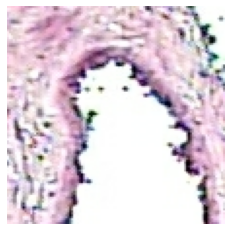

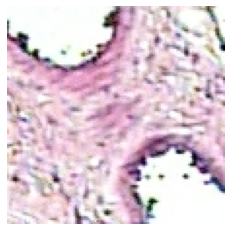

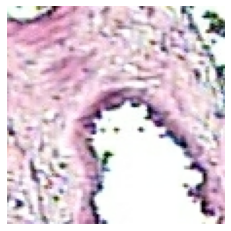

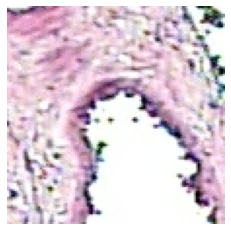

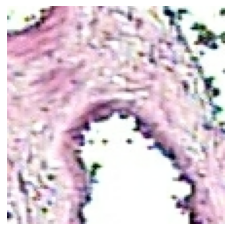

...

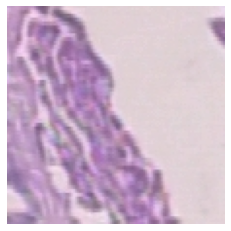

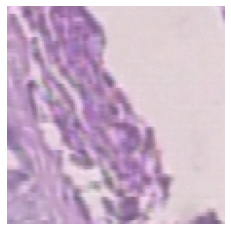

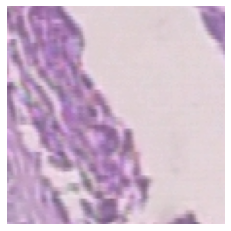

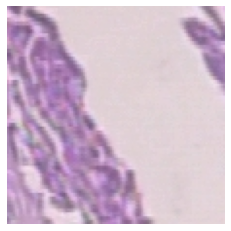

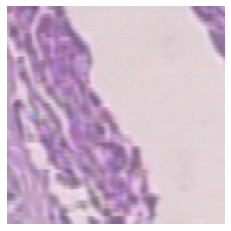

In [ ]:
def show(im):
  plt.figure()
  plt.imshow(im)
  plt.axis('off')

for im in tf.unstack(the_env._cur_batch[0]):
  show(tf.clip_by_value(im, 0.,1.))

In [ ]:
tmp = [0 for _ in range(19)]
tmp.append( tst.reward)
reward =tst.reward

In [ ]:
actions = np.array(actions)
select = actions[:, 0]
lx = np.array([ l[0] for l in actions[:,1]])
ly = np.array([ l[1] for l in actions[:,1]])
acts = [select, lx, ly]
actions_space = [2, 460, 700]


with tf.GradientTape() as policy_tape:
  outputs = [ De_Net(get_input(states[i:i+4])) for i in range(0, len(states), 4) ]
  t = [ np.array([tf.unstack(a)  for a in output]).T for output in outputs]
  logits = np.array([ [tf.nn.log_softmax(a) for a in o] for out in t for o in out ])

  # logits = [[ tf.nn.log_softmax(b) for b in a]  for a in logits_list]
  one_hot = [tf.one_hot(a, n) for a,n in zip(acts, actions_space)]

  log_probs = [ tf.math.reduce_sum(tf.stack(l)* o, axis=1) for l, o in zip(logits.T, one_hot)]

  policy_loss = -tf.math.reduce_mean(log_probs* tf.stop_gradient(reward), axis = 1)

policy_variables = De_Net.trainable_variables
grads = policy_tape.gradient(policy_loss, policy_variables)
De_Net.optimizer.apply_gradients(zip(grads, policy_variables))

<tf.Variable 'UnreadVariable' shape=() dtype=int64, numpy=3>

In [ ]:
actions = [ [1, [randint(0,459), randint(0,699)]] for _ in range(4)]
rews = []
actions_h = []
# while True:
obs = []

for action in actions:
  timestep = environment.step(action)
  obs.append(timestep.observation)
  rews.append(timestep.reward)
  actions_h.append(action)
#     if timestep.reward >0 :
#       break
  
#   if timestep.reward >0 :
#     break    
#   actions = get_action(De_Net, np.array(obs))

observations = np.array(obs)
deep_inp = observations[:,-128:].reshape(4,1,128)
stats = observations[:,:7].reshape(4,1,7)
deep_inp_tensor = tf.convert_to_tensor(deep_inp)
stats_tensor = tf.convert_to_tensor(stats)

l, a = De_Net.fit([deep_inp_tensor, stats_tensor], steps_per_epoch=1, epochs=1)


1/1 [==============================] - 0s 852us/step - loss: 2.0793 - accuracy: 0.0000e+00
pred
features
1/1 [==============================] - 0s 726us/step - loss: 2.0793 - accuracy: 0.0000e+00
pred
features
1/1 [==============================] - 0s 1ms/step - loss: 2.0793 - accuracy: 0.0000e+00
pred
features
1/1 [==============================] - 0s 758us/step - loss: 2.0793 - accuracy: 0.0000e+00
pred
features


ValueError: ignored

In [ ]:
class ActionNet(network.Network):

  def __init__(self, input_tensor_spec, output_tensor_spec, model=De_Net):
    super(ActionNet, self).__init__(
        input_tensor_spec=input_tensor_spec,
        state_spec=(),
        name='ActionNet')
    self._output_tensor_spec = output_tensor_spec   
    self._model=model
    self.location = [random(),random()]

  def call(self, observations, step_type, network_state):
    del step_type
    # TODO observations as tensors
    deep_inp = tf.convert_to_tensor(observations[-128:].reshape(1,1,128))
    stats = tf.convert_to_tensor(np.append(observations[:5],self.location).reshape(1,1,7))
    
    output = self._model([deep_inp, stats]).numpy()[0]
    to_crop = 1 if output[0]>0 else 0
    self.location = output[1:]
    patches = 
    actions = [to_crop, patches]

    # Scale and shift actions to the correct range if necessary.
    return actions, network_state


# Convolutional Custom Model

In [ ]:
from tensorflow.keras import Model
from tensorflow.keras.layers import Input, Dense, Dropout, Conv2D, MaxPool2D,GlobalMaxPool2D,Flatten
from tensorflow.keras.layers.experimental.preprocessing import Normalization

inputs = Input((400,400,3), name='input')

x = Conv2D(32, 3, strides=2)(inputs)
x = Conv2D(32, 3)(x)
x = Conv2D(32, 3)(x)
x = MaxPool2D(3, 1)(x)
x = Dropout(0.25)(x)

x = Conv2D(64, 5)(x)
x = Conv2D(64, 5)(x)
x = MaxPool2D(5, 1)(x)
x = Dropout(0.25)(x)

x = Conv2D(128, 7)(x)
x = MaxPool2D(7, 1)(x)
x = Conv2D(256, 7)(x)
x = GlobalMaxPool2D()(x)

x = Dropout(0.25)(x)
x = Dense(256)(x)
x = Dropout(0.25)(x)

output = Dense(8, activation='softmax', name='output')(x)

model = Model(inputs=[inputs], outputs=[output])

model.summary()
model.compile(optimizer=tf.optimizers.Adam(), loss=tf.keras.losses.sparse_categorical_crossentropy , metrics=["accuracy"])


Model: "model_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input (InputLayer)           [(None, 400, 400, 3)]     0         
_________________________________________________________________
conv2d_154 (Conv2D)          (None, 199, 199, 32)      896       
_________________________________________________________________
conv2d_155 (Conv2D)          (None, 197, 197, 32)      9248      
_________________________________________________________________
conv2d_156 (Conv2D)          (None, 195, 195, 32)      9248      
_________________________________________________________________
max_pooling2d_83 (MaxPooling (None, 193, 193, 32)      0         
_________________________________________________________________
conv2d_157 (Conv2D)          (None, 189, 189, 64)      51264     
_________________________________________________________________
conv2d_158 (Conv2D)          (None, 185, 185, 64)      1024

In [ ]:
history = model.fit(train_ds, epochs=5, steps_per_epoch=steps, validation_data=val_ds, validation_steps=val_size//batch_size)

Epoch 1/5
61/61 [==============================] - 392s 6s/step - loss: 182.7268 - accuracy: 0.2246 - val_loss: 56.3968 - val_accuracy: 0.1953
Epoch 2/5
61/61 [==============================] - 397s 7s/step - loss: 15.7694 - accuracy: 0.3202 - val_loss: 15.2278 - val_accuracy: 0.2617
Epoch 3/5
61/61 [==============================] - 398s 7s/step - loss: 5.4224 - accuracy: 0.3809 - val_loss: 11.5273 - val_accuracy: 0.3125
Epoch 4/5
61/61 [==============================] - 398s 7s/step - loss: 4.5104 - accuracy: 0.4073 - val_loss: 7.1926 - val_accuracy: 0.3008
Epoch 5/5
61/61 [==============================] - 394s 6s/step - loss: 2.7237 - accuracy: 0.4890 - val_loss: 7.3992 - val_accuracy: 0.2578


In [ ]:
history = model.fit(train_ds, epochs=15,initial_epoch=10, steps_per_epoch=steps, validation_data=val_ds, validation_steps=val_size// batch_size)


Epoch 6/10
61/61 [==============================] - 396s 6s/step - loss: 2.3341 - accuracy: 0.5141 - val_loss: 8.7878 - val_accuracy: 0.2500
Epoch 7/10
61/61 [==============================] - 396s 6s/step - loss: 2.3795 - accuracy: 0.5013 - val_loss: 5.9287 - val_accuracy: 0.3086
Epoch 8/10
61/61 [==============================] - 398s 7s/step - loss: 1.9197 - accuracy: 0.5430 - val_loss: 6.3856 - val_accuracy: 0.3281
Epoch 9/10
61/61 [==============================] - 398s 7s/step - loss: 1.5120 - accuracy: 0.5991 - val_loss: 6.8081 - val_accuracy: 0.2695
Epoch 10/10
61/61 [==============================] - 398s 7s/step - loss: 1.5462 - accuracy: 0.6037 - val_loss: 5.8762 - val_accuracy: 0.2891


# Evaluate

In [ ]:
# plot diagnostic learning curves
def summarize_diagnostics(history):
	plt.figure(figsize=(16, 8))
	plt.suptitle('Training Curves')
	# plot loss
	plt.subplot(121)
	plt.title('Cross Entropy Loss')
	plt.plot(history.history['loss'], color='blue', label='train')
	plt.plot(history.history['val_loss'], color='orange', label='val')
	plt.legend(loc='upper right')
	# plot accuracy
	plt.subplot(122)
	plt.title('Classification Accuracy')
	plt.plot(history.history['sparse_categorical_accuracy'], color='blue', label='train')
	plt.plot(history.history['val_sparse_categorical_accuracy'], color='orange', label='val')
	plt.legend(loc='lower right')
	return plt
 
# print test set evaluation metrics
def model_evaluation(test_ds, model, evaluation_steps):
	print('\nTest set evaluation metrics')
	loss0,accuracy0 = model.evaluate(test_ds, steps = evaluation_steps)
	print("loss: {:.2f}".format(loss0))
	print("accuracy: {:.2f}".format(accuracy0))
	return loss0,accuracy0

# the addition we made here is that the plots may be saved to a given directory
def model_report(test_ds, model, history, evaluation_steps = 10, direc = None):
	plt = summarize_diagnostics(history)
	if direc != None:
		plt.savefig(direc)
	plt.show()
	return model_evaluation(test_ds, model, evaluation_steps)

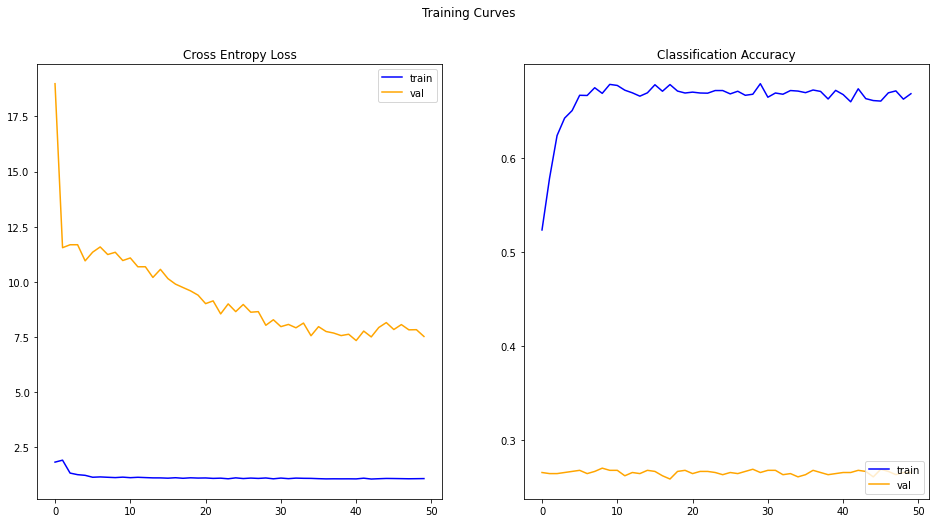


Test set evaluation metrics
51/51 [==============================] - 2s 38ms/step - loss: 5.3219 - sparse_categorical_accuracy: 0.4375
loss: 5.32
accuracy: 0.44


(5.321854114532471, 0.4375)

In [ ]:
model_report(test_ds, hope_model, history, evaluation_steps=test_size//batch_size)
